In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
print("Importing MONAI")
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Importing MONAI


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 1), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)
   
    def training_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars(ExperimentDescription, {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='I-AE{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])

In [3]:
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir   = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc) # , num_workers=1
val_dataset   = CacheDataset(val_dataset_uc  ) # , num_workers=1

train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True ) # ,  num_workers=1
val_dataloader   = DataLoader(val_dataset,   batch_size=2, shuffle=False) # ,  num_workers=1

Loading dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Loading dataset:   4%|▎         | 1/28 [00:07<03:12,  7.12s/it]

Loading dataset:   7%|▋         | 2/28 [00:20<04:43, 10.89s/it]

Loading dataset:  11%|█         | 3/28 [00:27<03:51,  9.27s/it]

Loading dataset:  14%|█▍        | 4/28 [00:35<03:24,  8.51s/it]

Loading dataset:  18%|█▊        | 5/28 [00:42<03:06,  8.12s/it]

Loading dataset:  21%|██▏       | 6/28 [00:49<02:45,  7.53s/it]

Loading dataset:  25%|██▌       | 7/28 [00:55<02:31,  7.20s/it]

Loading dataset:  29%|██▊       | 8/28 [01:05<02:42,  8.12s/it]

Loading dataset:  32%|███▏      | 9/28 [01:15<02:45,  8.72s/it]

Loading dataset:  36%|███▌      | 10/28 [01:22<02:26,  8.12s/it]

Loading dataset:  39%|███▉      | 11/28 [01:28<02:04,  7.30s/it]

Loading dataset:  43%|████▎     | 12/28 [01:37<02:07,  7.96s/it]

Loading dataset:  46%|████▋     | 13/28 [01:49<02:19,  9.32s/it]

Loading dataset:  50%|█████     | 14/28 [01:57<02:03,  8.81s/it]

Loading dataset:  54%|█████▎    | 15/28 [02:05<01:51,  8.56s/it]

Loading dataset:  57%|█████▋    | 16/28 [02:10<01:28,  7.37s/it]

Loading dataset:  61%|██████    | 17/28 [02:17<01:19,  7.24s/it]

Loading dataset:  64%|██████▍   | 18/28 [02:25<01:16,  7.69s/it]

Loading dataset:  68%|██████▊   | 19/28 [02:42<01:32, 10.29s/it]

Loading dataset:  71%|███████▏  | 20/28 [02:46<01:07,  8.40s/it]

Loading dataset:  75%|███████▌  | 21/28 [02:55<01:01,  8.80s/it]

Loading dataset:  79%|███████▊  | 22/28 [03:03<00:50,  8.42s/it]

Loading dataset:  82%|████████▏ | 23/28 [03:11<00:41,  8.30s/it]

Loading dataset:  86%|████████▌ | 24/28 [03:22<00:36,  9.13s/it]

Loading dataset:  89%|████████▉ | 25/28 [03:31<00:27,  9.10s/it]

Loading dataset:  93%|█████████▎| 26/28 [03:40<00:17,  8.92s/it]

Loading dataset:  96%|█████████▋| 27/28 [03:45<00:07,  7.95s/it]

Loading dataset: 100%|██████████| 28/28 [03:50<00:00,  6.96s/it]

Loading dataset: 100%|██████████| 28/28 [03:50<00:00,  8.23s/it]

Loading dataset:   0%|          | 0/12 [00:00<?, ?it/s]

Loading dataset:   8%|▊         | 1/12 [00:07<01:20,  7.29s/it]

Loading dataset:  17%|█▋        | 2/12 [00:13<01:07,  6.77s/it]

Loading dataset:  25%|██▌       | 3/12 [00:19<00:56,  6.27s/it]

Loading dataset:  33%|███▎      | 4/12 [00:34<01:19,  9.95s/it]

Loading dataset:  42%|████▏     | 5/12 [00:42<01:03,  9.11s/it]

Loading dataset:  50%|█████     | 6/12 [00:50<00:52,  8.68s/it]

Loading dataset:  58%|█████▊    | 7/12 [01:02<00:48,  9.69s/it]

Loading dataset:  67%|██████▋   | 8/12 [01:09<00:35,  8.79s/it]

Loading dataset:  75%|███████▌  | 9/12 [01:17<00:26,  8.74s/it]

Loading dataset:  83%|████████▎ | 10/12 [01:26<00:17,  8.79s/it]

Loading dataset:  92%|█████████▏| 11/12 [01:36<00:09,  9.03s/it]

Loading dataset: 100%|██████████| 12/12 [01:44<00:00,  8.79s/it]

Loading dataset: 100%|██████████| 12/12 [01:44<00:00,  8.70s/it]

In [4]:
trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


Missing logger folder: /old_Users/tgafrick/RA4/jobs/job13/lightning_logs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [3]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 2.1 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
2.1 M     Trainable params
0         Non-trainable params
2.1 M     Total params
8.236     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=79` in the `DataLoader` to improve performance.


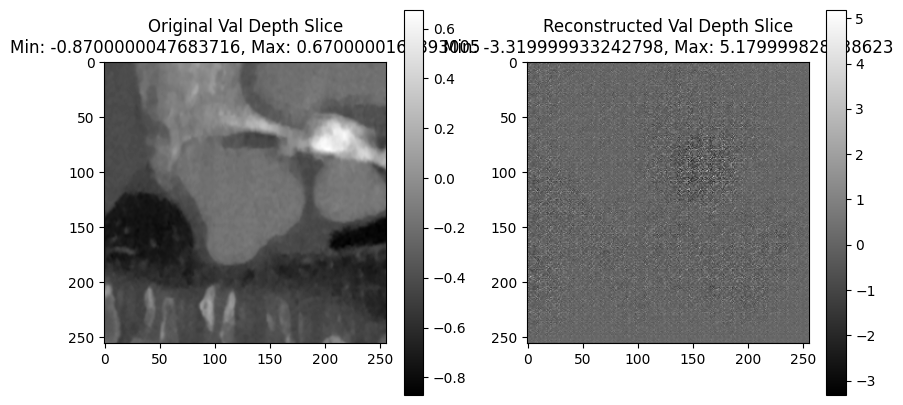

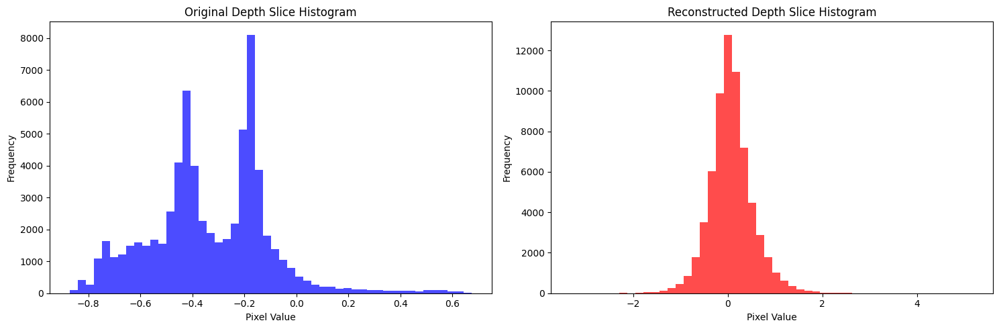

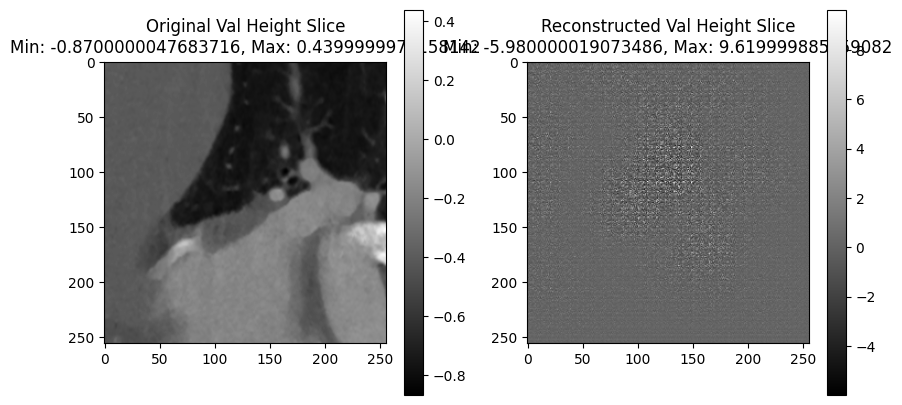

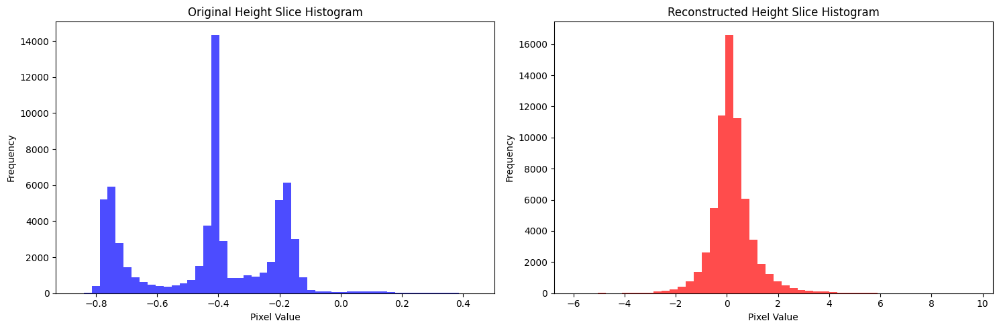

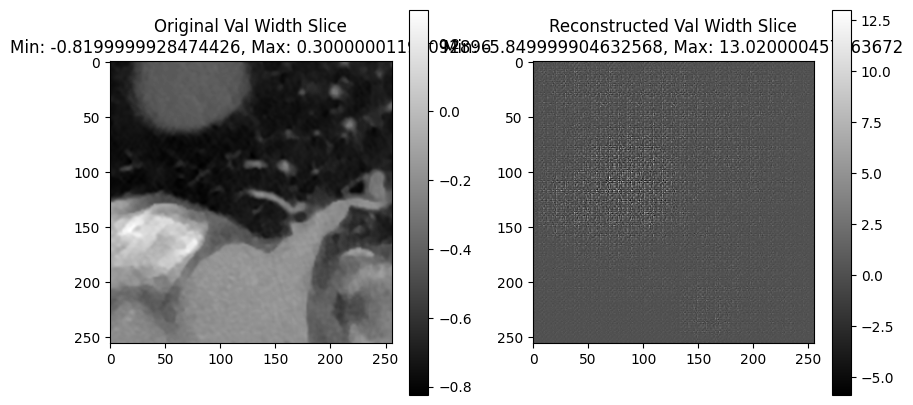

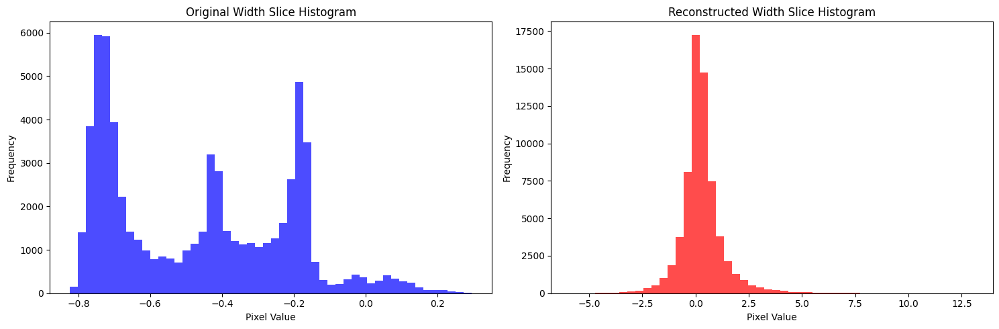

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=79` in the `DataLoader` to improve performance.
/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (14) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

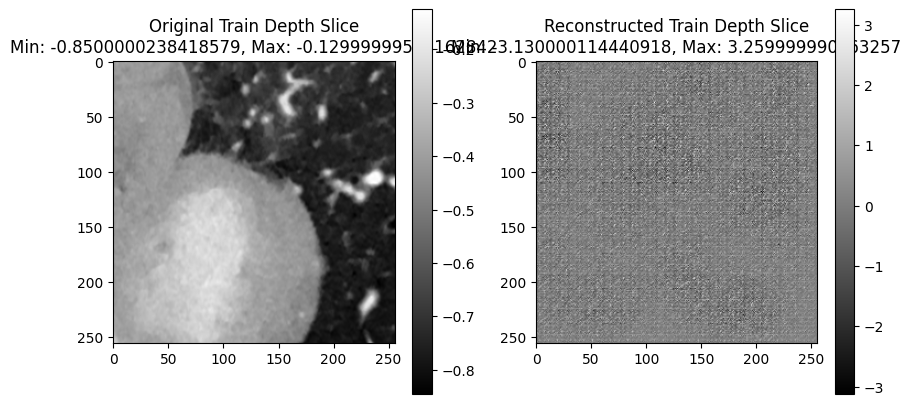

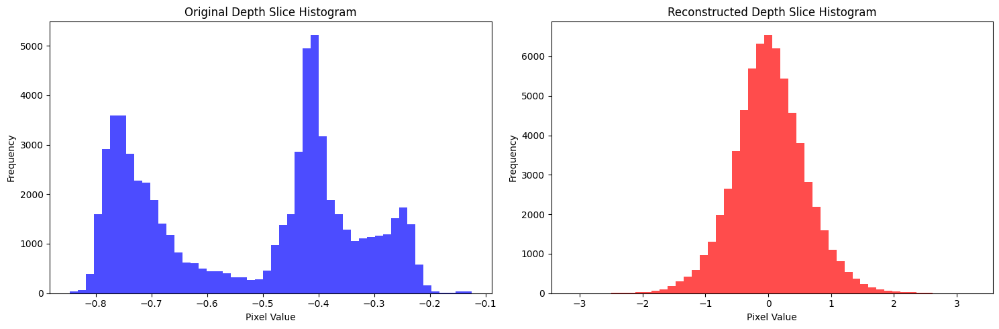

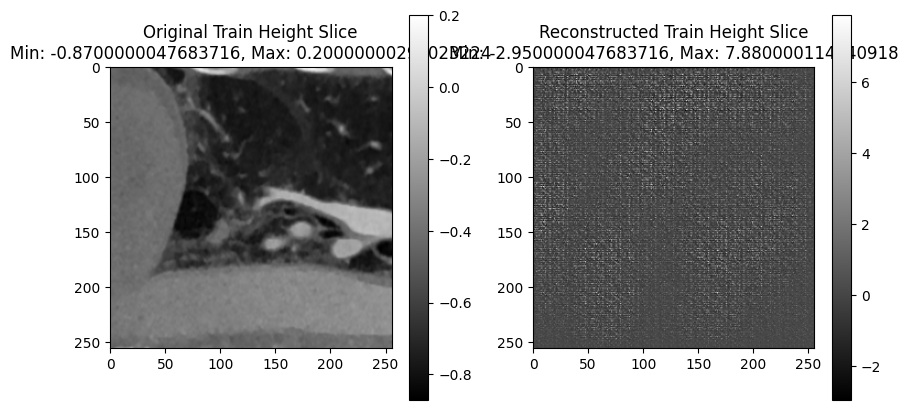

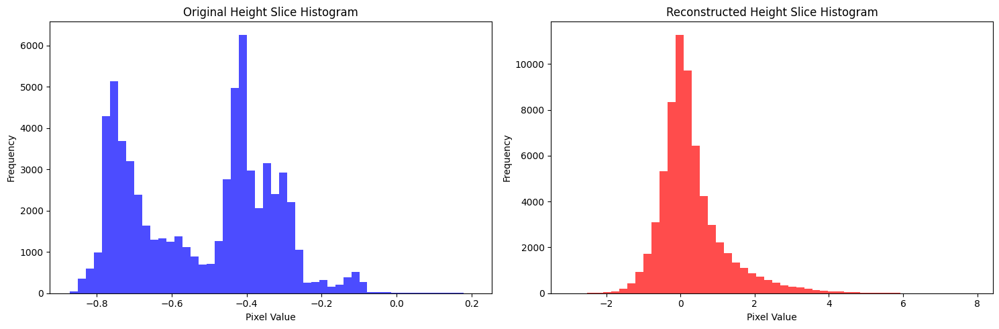

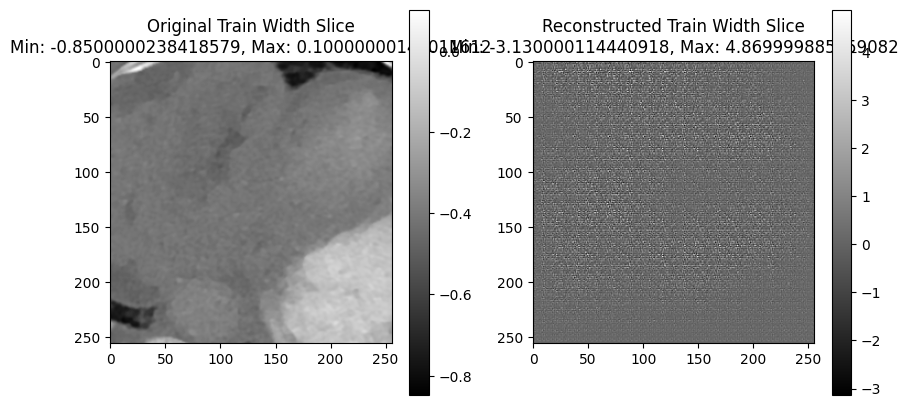

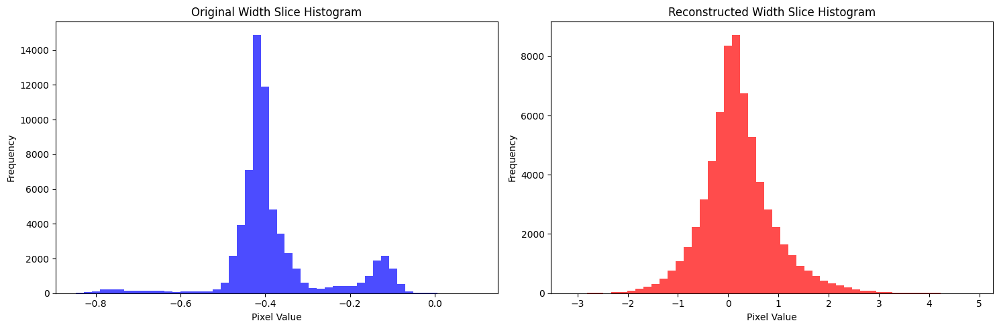

Validation: |          | 0/? [00:00<?, ?it/s]

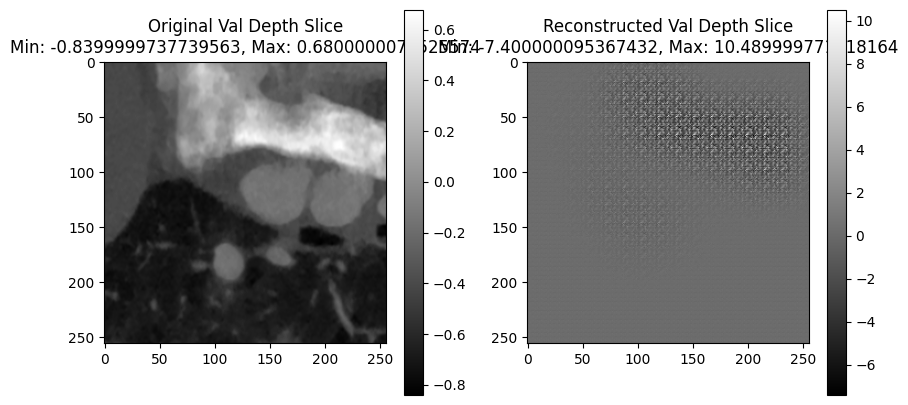

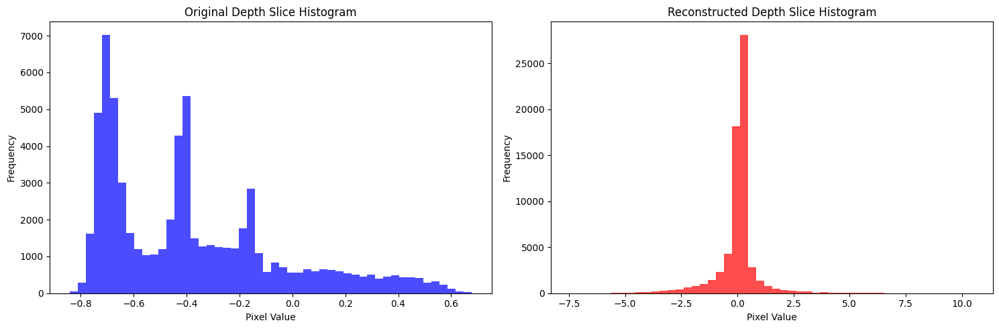

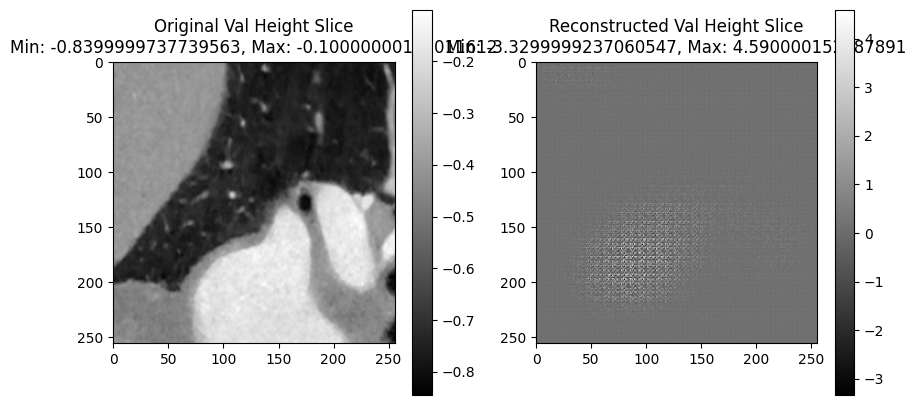

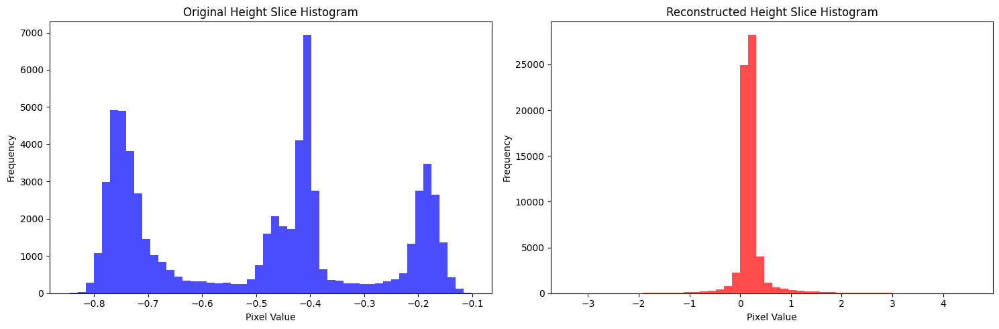

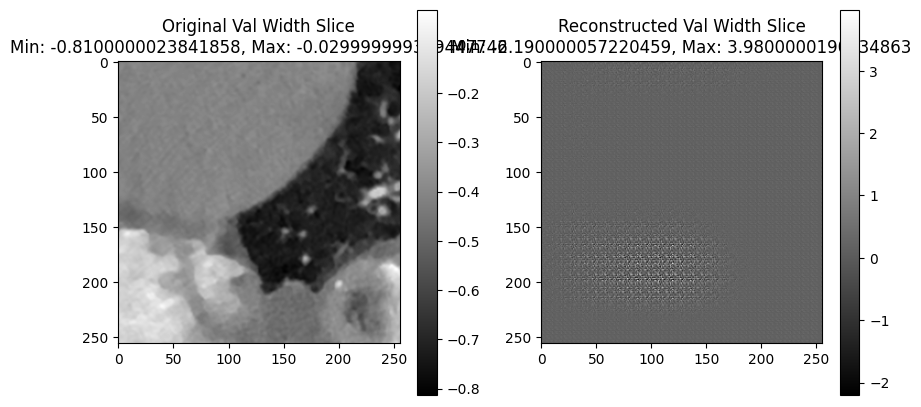

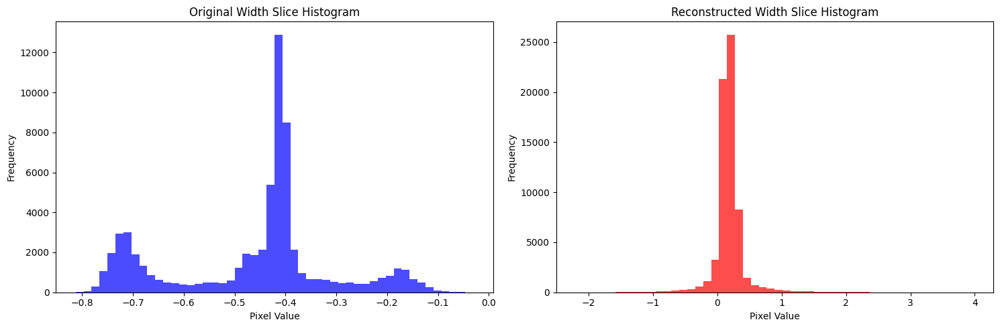

Time Spent 363.53
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 376.24
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 388.49
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 400.69
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 412.64
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 424.62
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 436.57
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 448.62
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 460.57
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 472.54
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 484.59
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 496.53
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 508.49
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 520.43
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 532.47
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 544.41
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 556.38
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 568.53
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 580.50
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 592.47
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 604.46
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 616.53
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 628.51
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 640.48
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 652.55
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 664.51
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 676.45
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 688.68
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 701.33
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 713.86
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 726.39
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 738.92
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 751.53
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 764.05
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 776.58
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 789.19
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 801.71
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 814.23
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 826.74
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 839.37
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 851.90
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 864.44
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 877.10
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 889.66
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 902.20
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 914.75
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 927.39
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 939.94
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 952.53
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 965.21
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 977.76
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 990.29
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1002.82
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1015.45
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1027.97
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1040.49
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1053.06
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1065.69
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1078.19
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1090.71
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1103.34
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1115.85
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1128.37
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1140.93
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1153.56
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1165.88
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1177.83
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1189.85
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1201.77
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1213.69
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1225.63
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1237.71
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1249.64
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1261.57
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1273.62
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1285.60
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1297.60
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1309.59
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1321.69
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1333.70
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1345.95
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1358.50
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1371.16
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1383.71
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1396.26
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1408.62
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1420.61
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1432.61
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1444.59
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1456.63
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1468.61
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1480.84
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1492.94
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1504.94
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1516.91
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1528.87
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1540.91
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1552.86
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1564.83
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1576.93
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1588.93
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1600.89
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1612.86
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1624.92
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1636.87
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1648.84
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1660.83
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1672.86
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1684.79
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1696.72
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1708.79
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1720.77
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1732.74
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1744.73
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1756.83
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1768.80
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1780.76
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1792.85
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1804.83
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1816.80
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1828.77
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1840.84
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1852.87
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1864.87
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1876.95
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1889.23
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1901.77
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1914.29
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1926.92
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1939.51
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1952.03
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1964.57
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1977.22
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1989.76
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2002.30
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2014.93
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2027.51
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2040.18
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2052.75
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2065.40
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2077.94
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2090.47
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2103.07
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2115.63
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2128.18
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2140.79
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2153.42
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2165.97
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2178.61
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2191.25
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2203.79
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2216.33
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2228.87
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2241.51
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2254.08
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2266.62
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2279.18
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2291.85
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2304.42
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2316.98
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2329.65
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2342.21
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2354.98
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2367.54
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2380.19
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2392.73
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2405.61
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2418.26
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2430.78
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2443.37
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2456.14
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2468.80
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2481.36
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2493.90
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2506.55
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2519.09
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2531.64
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2544.20
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2556.84
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2569.39
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2581.94
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2594.51
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2607.28
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2619.83
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2632.38
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2645.07
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2657.64
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2670.20
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2682.76
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2695.42
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2708.15
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2720.72
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2733.38
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2746.00
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2758.54
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2771.11
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2783.75
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2796.32
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2808.96
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2821.64
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2834.31
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2846.89
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2859.41
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2872.06
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2884.63
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2897.15
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2909.68
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2922.32
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2934.97
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2947.51
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2960.28
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2972.89
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2985.46
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2997.97
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3010.60
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3023.12
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3035.67
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3048.32
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3060.85
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3073.38
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3085.91
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3098.58
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3111.11
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3123.66
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3136.33
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3148.88
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3161.43
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3173.98
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3186.38
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3198.37
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3210.35
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3222.81
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3235.46
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3248.01
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3260.07
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3272.14
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3284.47
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3296.44
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3308.39
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3320.49
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3332.77
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3344.73
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3357.07
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3369.34
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3381.36
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3393.40
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3405.46
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3417.43
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3429.40
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3441.55
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3453.54
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3466.45
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3479.45
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3492.17
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3504.68
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3517.24
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3529.79
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3542.51
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3555.13
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3567.43
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3579.55
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3591.60
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3603.59
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3619.54
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3634.16
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3649.25
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3661.20
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3675.74
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3687.93
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3702.73
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3714.71
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3726.81
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3738.76
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3750.74
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3762.85
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3774.83
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3786.82
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3798.77
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3810.85
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3823.27
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3835.84
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3848.41
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3861.06
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3873.67
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3886.24
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3898.42
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3910.50
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3922.49
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3934.51
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3946.65
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3958.66
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3970.69
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3982.82
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3995.17
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4007.71
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4020.26
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4032.65
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4044.63
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4056.59
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4068.68
Epoch: 300


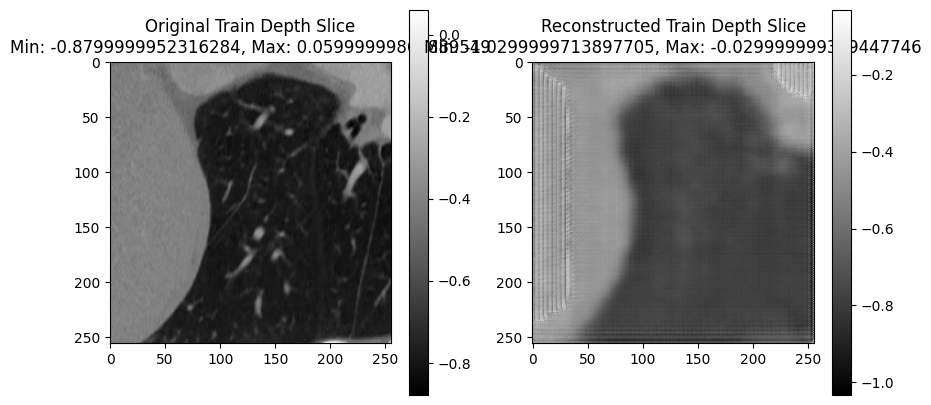

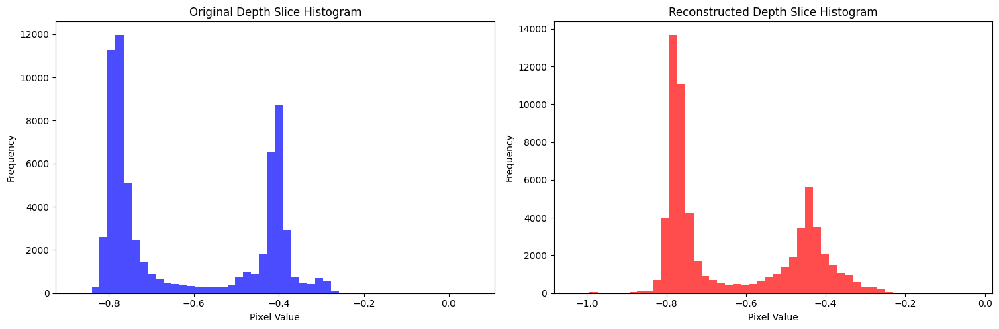

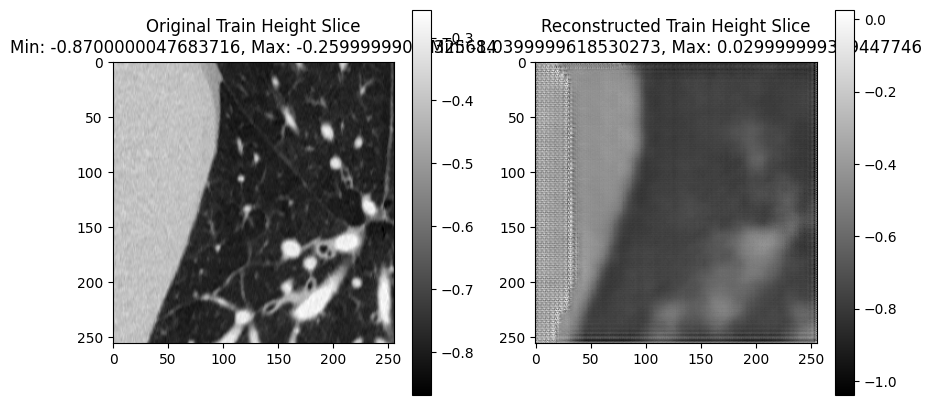

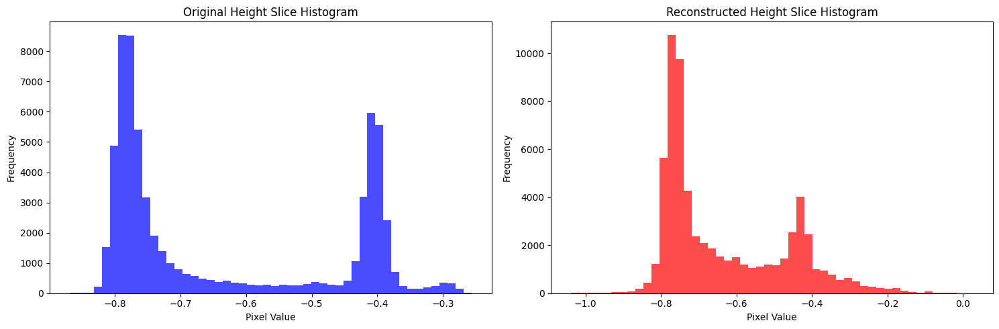

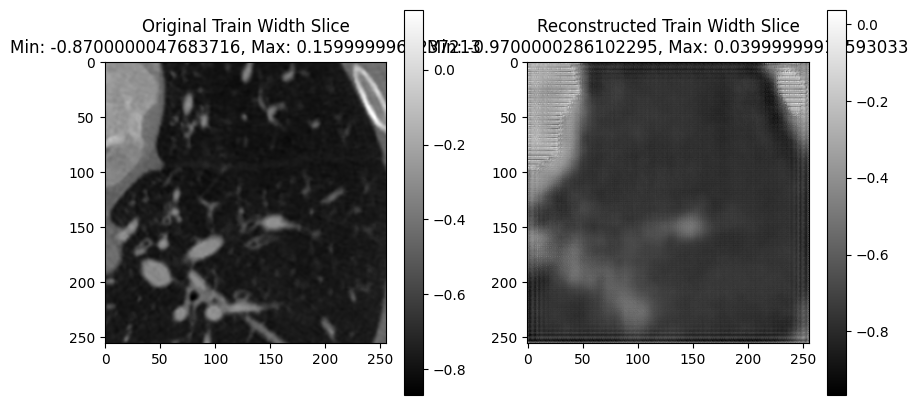

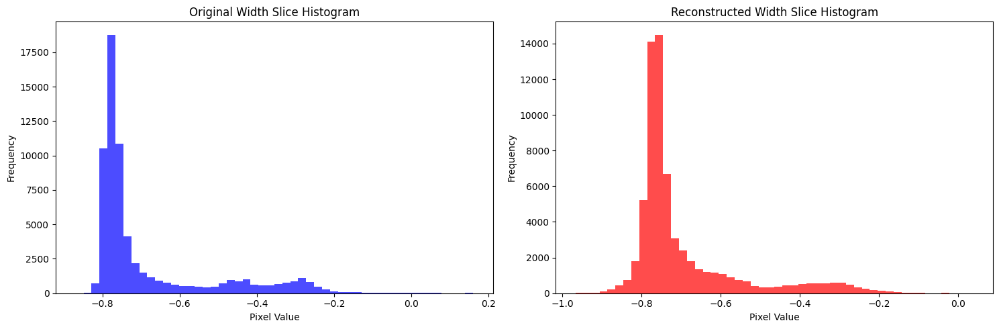

Validation: |          | 0/? [00:00<?, ?it/s]

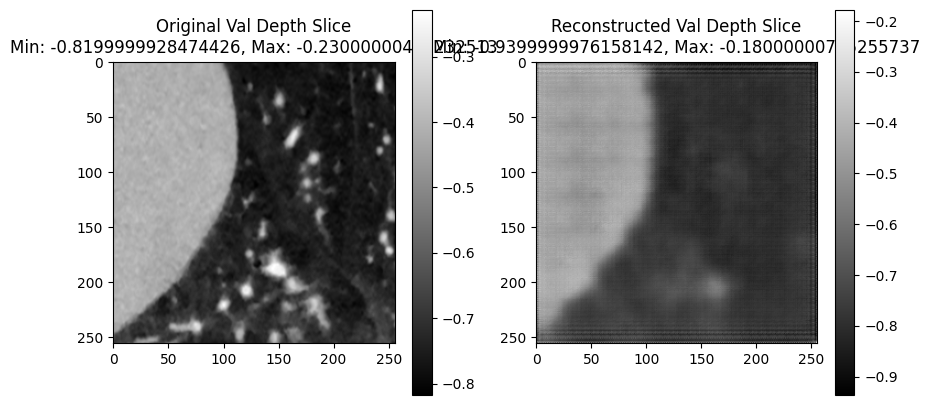

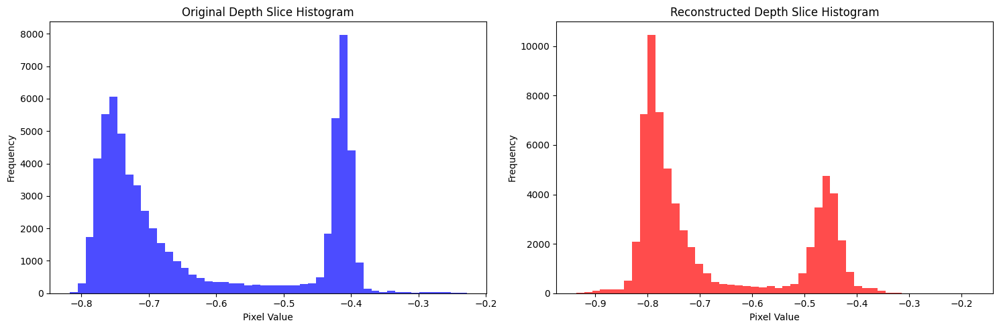

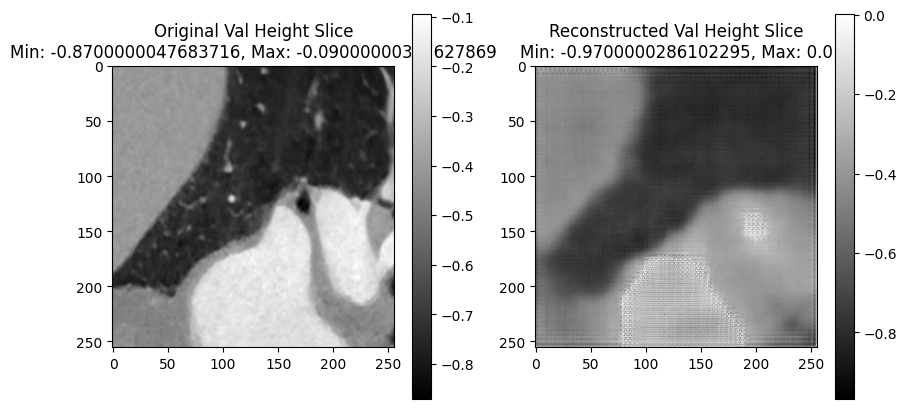

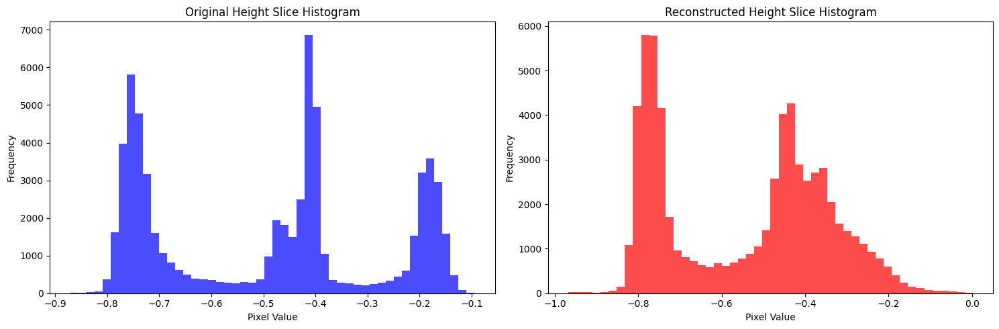

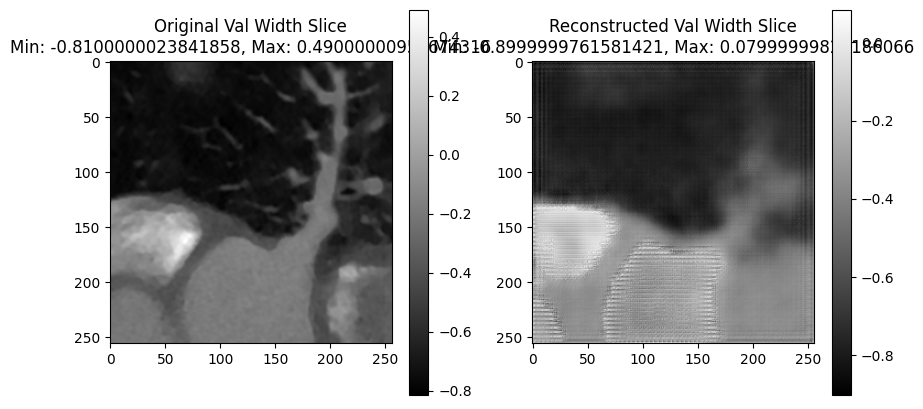

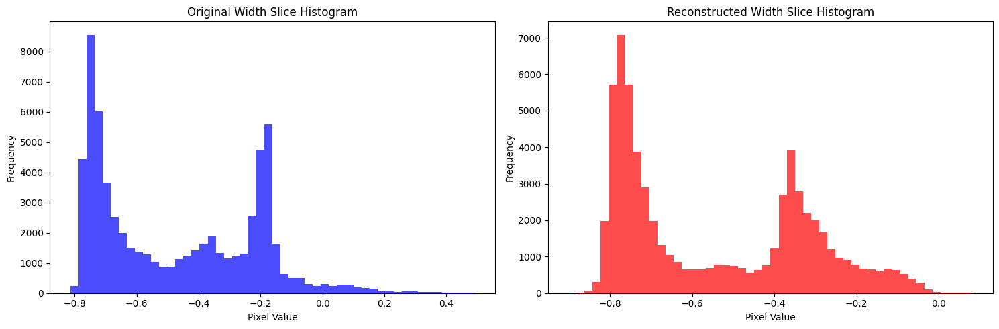

Time Spent 4087.85
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4099.82
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4111.79
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4123.82
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4136.19
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4148.74
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4161.39
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4174.14
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4186.69
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4199.24
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4211.93
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4224.07
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4236.63
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4249.19
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4261.86
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4274.24
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4286.24
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4298.31
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4310.29
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4322.28
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4334.29
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4346.62
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4359.18
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4371.73
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4384.38
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4397.06
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4409.60
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4421.64
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4433.92
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4446.51
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4459.08
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4471.66
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4483.80
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4495.77
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4507.95
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4520.62
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4533.15
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4545.71
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4558.34
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4571.01
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4583.30
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4595.26
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4607.36
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4619.34
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4631.31
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4643.28
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4655.84
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4668.39
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4681.01
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4693.69
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4706.24
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4718.27
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4730.22
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4742.31
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4754.29
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4766.27
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4778.32
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4790.42
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4802.39
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4814.36
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4826.75
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4839.30
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4851.84
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4864.39
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4876.96
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4888.99
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4900.95
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4913.02
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4925.08
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4937.12
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4949.10
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4961.21
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4973.34
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4985.34
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4997.93
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5010.48
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5022.65
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5034.87
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5047.53
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5059.85
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5071.86
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5083.83
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5095.88
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5107.83
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5119.79
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5131.90
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5143.87
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5155.86
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5167.85
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5179.93
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5191.93
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5203.96
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5216.03
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5228.03
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5240.04
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5252.06
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5264.14
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5276.10
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5288.08
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5300.27
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5312.73
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5325.31
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5337.70
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5350.14
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5362.15
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5374.12
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5386.08
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5398.13
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5410.10
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5422.06
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5434.18
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5446.14
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5458.09
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5470.06
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5482.13
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5494.13
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5506.10
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5518.18
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5530.14
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5542.08
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5554.07
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5566.16
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5578.13
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5590.12
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5602.23
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5614.24
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5626.25
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5638.31
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5650.35
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5662.40
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5674.40
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5687.18
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5699.38
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5711.36
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5723.37
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5735.45
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5747.63
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5760.19
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5772.39
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5784.73
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5797.07
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5809.15
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5821.33
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5833.30
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5845.54
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5857.77
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5869.84
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5881.82
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5893.77
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5906.15
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5918.71
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5931.30
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5943.92
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5956.59
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5969.16
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5981.74
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5994.31
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6006.96
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6019.54
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6031.83
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6043.93
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6055.90
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6068.27
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6080.82
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6093.58
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6105.98
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6118.23
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6131.01
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6143.66
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6156.33
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6169.02
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6181.77
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6194.02
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6206.49
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6218.65
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6230.72
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6242.85
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6254.99
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6267.12
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6279.35
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6291.34
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6303.35
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6315.48
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6327.55
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6339.54
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6351.74
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6363.84
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6375.82
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6388.36
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6401.09
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6413.63
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6426.20
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6438.74
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6450.75
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6462.75
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6474.77
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6486.95
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6498.95
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6510.96
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6523.29
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6535.84
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6548.38
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6561.61
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6573.95
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6585.95
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6597.93
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6609.94
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6622.97
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6635.54
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6648.19
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6660.85
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6673.58
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6686.13
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6698.68
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6711.36
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6723.58
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6735.55
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6747.79
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6759.75
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6771.75
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6783.89
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6795.98
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6808.30
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6820.87
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6833.58
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6846.15
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6858.45
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6870.55
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6882.61
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6894.67
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6906.62
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6918.59
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6931.21
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6943.77
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6956.42
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6969.11
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6981.69
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6994.30
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7006.86
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7019.53
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7031.96
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7044.40
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7056.62
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7068.63
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7080.57
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7092.60
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7104.79
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7116.75
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7128.71
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7140.79
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7152.75
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7164.92
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7177.47
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7190.17
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7202.76
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7215.47
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7227.81
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7239.94
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7252.21
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7264.75
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7277.42
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7289.99
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7302.57
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7315.11
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7327.75
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7340.28
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7352.86
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7365.26
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7377.23
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7389.20
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7401.23
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7413.34
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7425.31
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7437.27
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7449.35
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7461.33
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7473.34
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7485.33
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7497.47
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7509.45
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7521.45
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7533.56
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7545.64
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7557.62
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7569.65
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7581.79
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7594.05
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7606.62
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7619.17
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7631.73
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7643.74
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7655.70
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7667.77
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7679.73
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7691.68
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7703.72
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7715.84
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7727.85
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7739.89
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7752.11
Epoch: 600


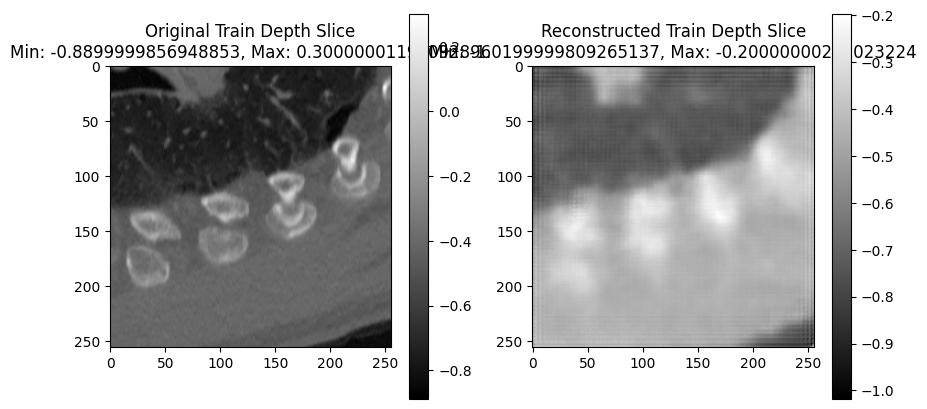

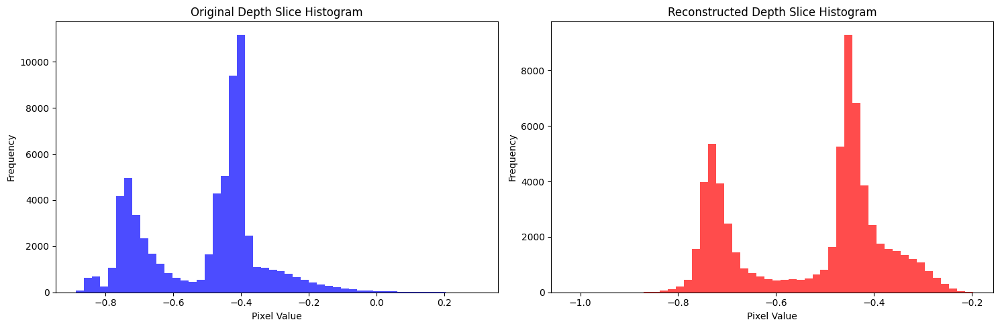

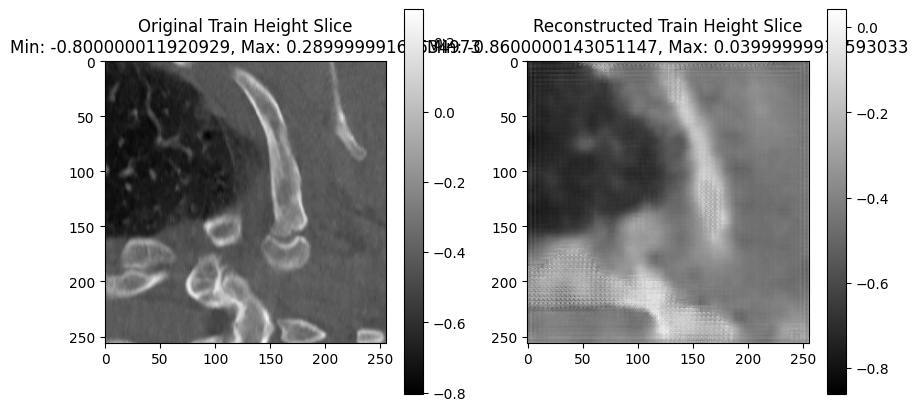

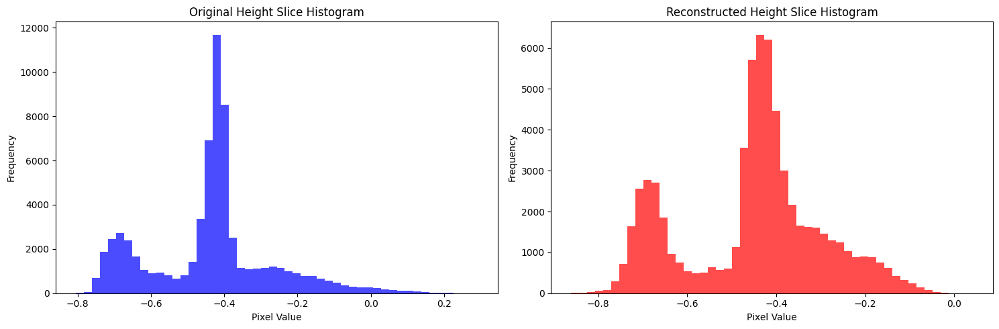

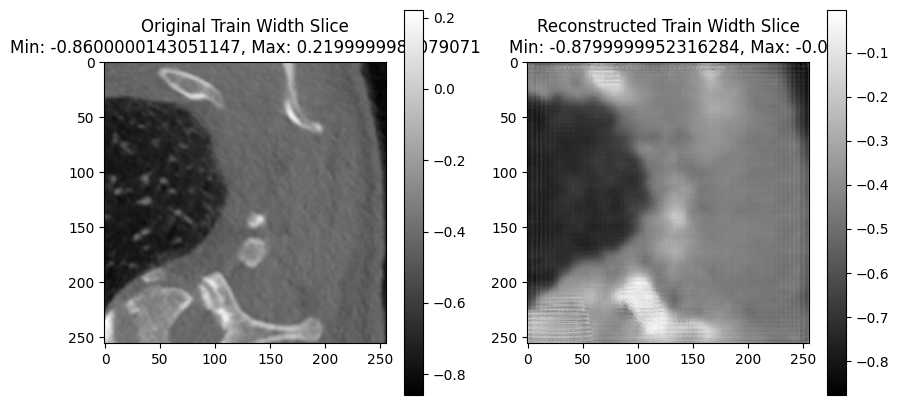

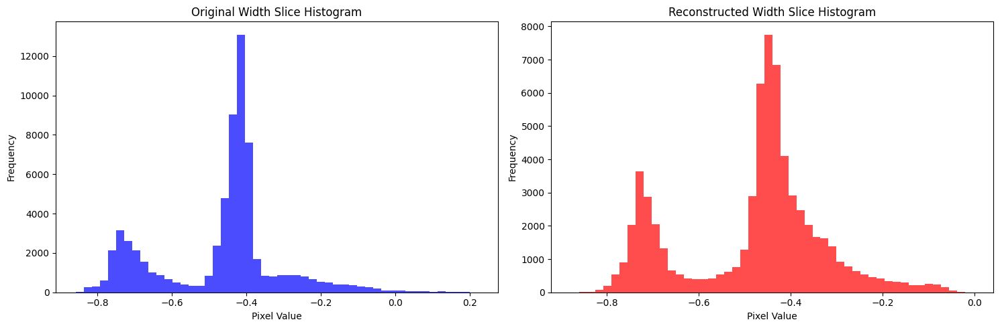

Validation: |          | 0/? [00:00<?, ?it/s]

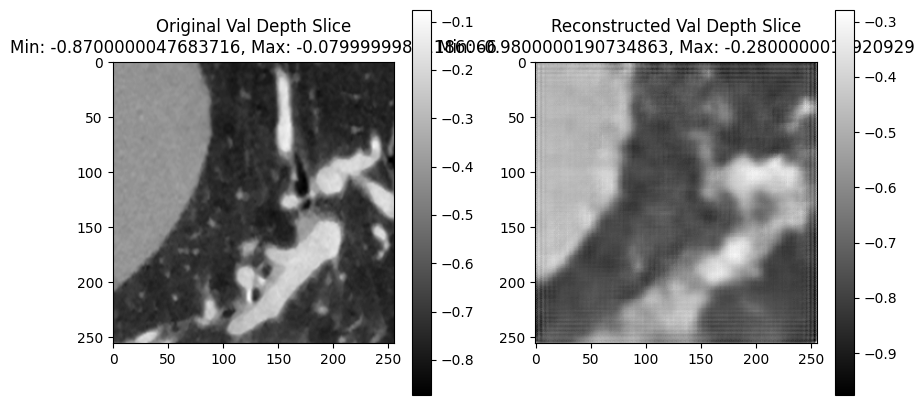

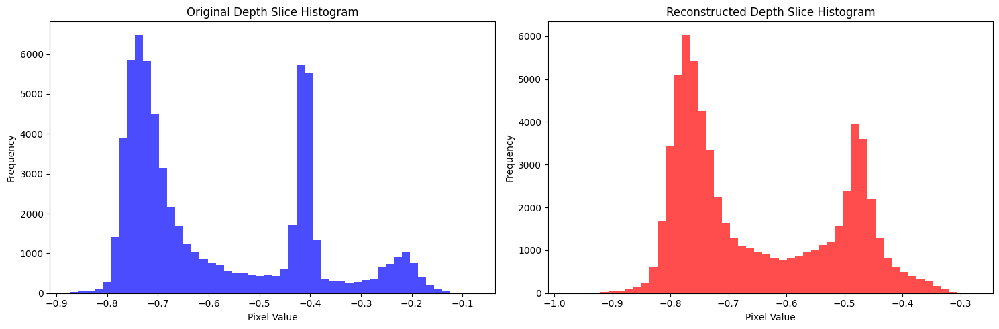

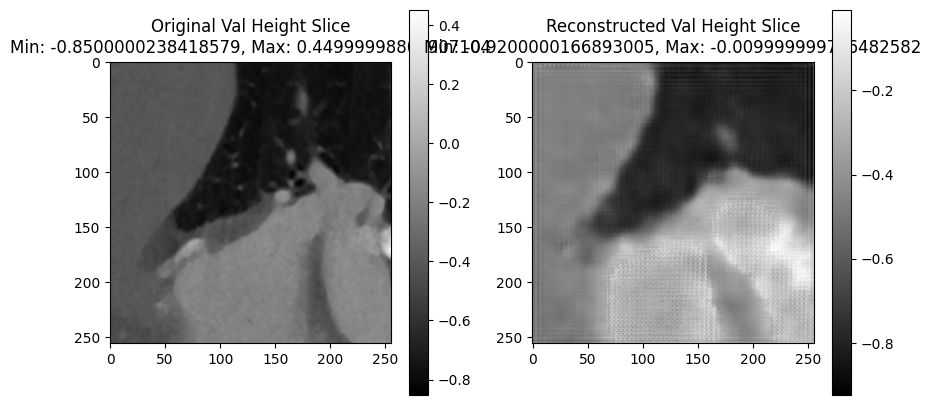

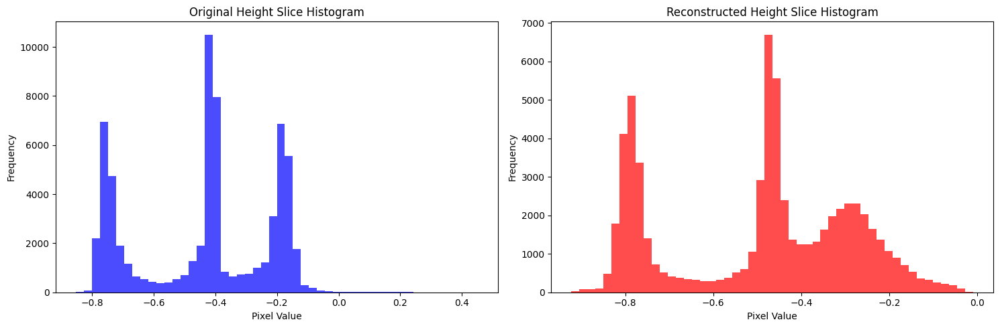

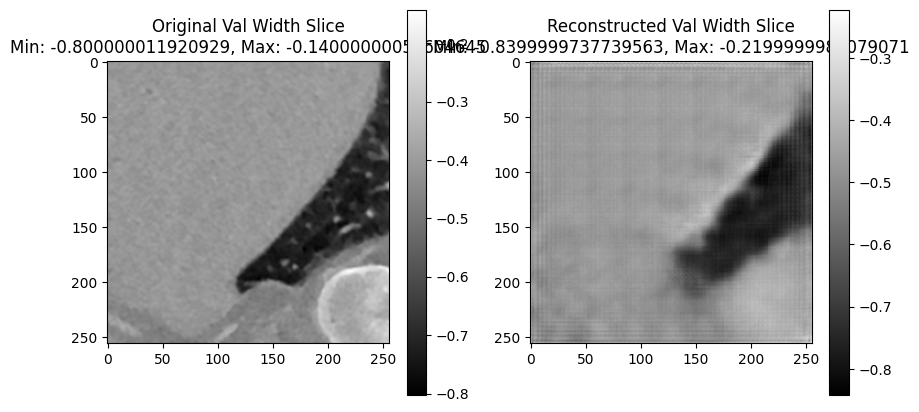

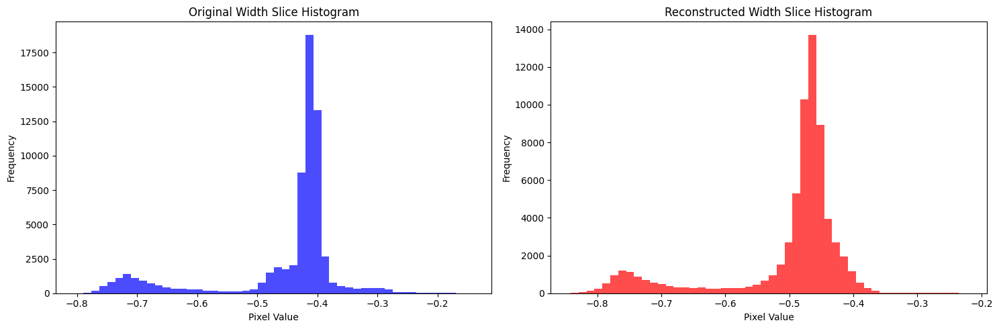

Time Spent 7771.65
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7783.61
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7795.58
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7807.65
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7819.62
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7831.60
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7843.56
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7855.81
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7867.79
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7879.74
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7891.80
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7903.78
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7915.76
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7927.73
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7939.80
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7951.76
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7963.74
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7975.83
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7987.79
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7999.94
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8012.34
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8024.46
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8036.97
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8049.36
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8061.50
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8073.60
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8085.60
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8097.57
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8109.63
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8121.56
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8133.62
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8145.85
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8157.94
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8169.92
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8181.89
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8193.96
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8205.92
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8217.90
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8229.85
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8241.95
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8253.95
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8265.94
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8277.99
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8290.02
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8302.02
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8314.03
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8326.11
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8338.24
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8350.47
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8362.99
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8375.04
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8387.00
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8399.02
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8411.05
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8423.08
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8435.04
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8447.04
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8459.15
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8471.16
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8483.16
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8495.54
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8508.07
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8520.61
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8533.16
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8545.36
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8557.35
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8569.35
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8581.42
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8593.36
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8605.55
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8617.82
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8630.50
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8643.05
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8655.68
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8668.36
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8680.97
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8693.55
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8705.62
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8717.81
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8730.19
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8742.74
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8755.29
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8767.73
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8779.69
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8791.70
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8803.80
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8815.83
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8827.86
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8839.83
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8852.35
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8864.97
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8877.54
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8890.37
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8902.96
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8915.49
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8927.87
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8939.98
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8951.92
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8964.12
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8976.45
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8988.48
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9000.47
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9012.43
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9024.51
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9036.49
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9048.45
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9060.41
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9072.51
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9084.55
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9096.50
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9108.57
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9120.55
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9132.54
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9144.52
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9156.85
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9169.39
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9181.94
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9194.57
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9207.11
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9219.68
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9232.24
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9244.93
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9257.50
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9270.08
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9282.59
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9294.61
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9307.06
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9319.63
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9332.32
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9344.70
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9356.99
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9369.00
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9381.31
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9393.70
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9406.07
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9418.75
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9431.28
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9443.59
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9456.05
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9468.49
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9480.54
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9492.55
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9504.64
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9516.63
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9528.60
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9540.54
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9552.59
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9564.59
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9576.54
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9588.64
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9600.62
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9612.60
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9624.58
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9636.63
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9648.62
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9660.76
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9672.77
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9684.85
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9696.81
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9708.77
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9720.83
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9732.78
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9744.73
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9756.70
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9768.78
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9780.77
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9792.77
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9804.86
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9817.06
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9829.01
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9840.99
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9853.05
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9865.00
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9877.26
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9889.92
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9902.49
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9914.55
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9926.50
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9938.58
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9950.80
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9963.09
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9975.08
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9987.17
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9999.16
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10011.69
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10024.36
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10036.95
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10049.51
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10062.10
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10074.77
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10087.33
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10099.57
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10111.68
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10123.65
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10135.61
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10147.57
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10159.68
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10171.70
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10183.64
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10195.83
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10207.96
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10219.98
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10232.36
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10245.09
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10257.70
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10270.36
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10282.96
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10295.72
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10308.32
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10320.90
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10333.65
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10346.23
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10358.81
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10371.05
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10383.13
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10395.15
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10407.24
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10419.38
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10431.38
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10443.51
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10455.97
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10468.11
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10480.06
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10492.01
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10504.24
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10516.19
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10528.16
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10540.13
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10552.21
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10564.17
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10576.11
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10588.12
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10600.24
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10612.22
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10624.20
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10636.27
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10648.28
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10660.47
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10672.77
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10685.23
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10698.19
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10710.86
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10724.15
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10739.27
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10752.59
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10764.65
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10776.81
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10788.79
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10800.80
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10814.31
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10826.76
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10839.25
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10851.54
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10864.48
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10876.77
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10890.73
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10902.91
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10916.14
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10937.51
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10953.27
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10965.66
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10978.15
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10990.86
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11002.87
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11015.61
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11028.28
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11040.97
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11053.59
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11066.27
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11083.89
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11095.93
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11108.05
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11120.74
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11134.42
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11147.48
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11160.78
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11173.56
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11188.20
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11200.89
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11213.47
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11230.58
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11308.29
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11323.25
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11369.64
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11409.14
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11422.68
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11453.74
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11477.67
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11489.67
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11501.73
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11513.69
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11525.69
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11537.78
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11549.76
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11561.74
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11574.18
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11586.29
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11598.29
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11610.27
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11622.37
Epoch: 900


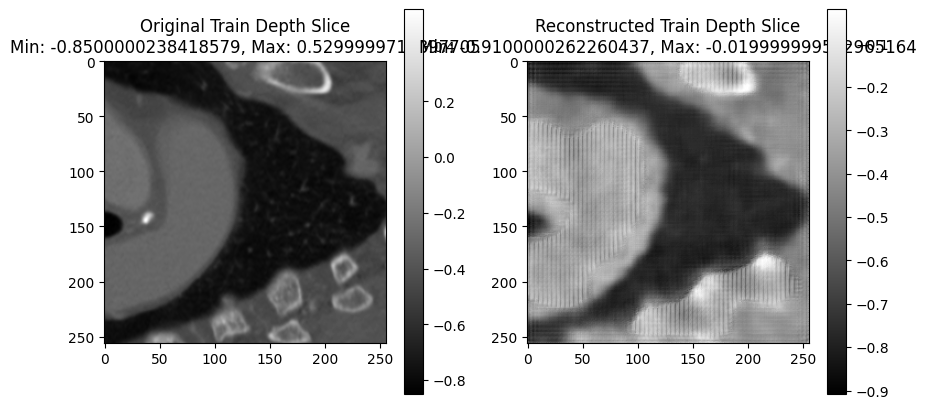

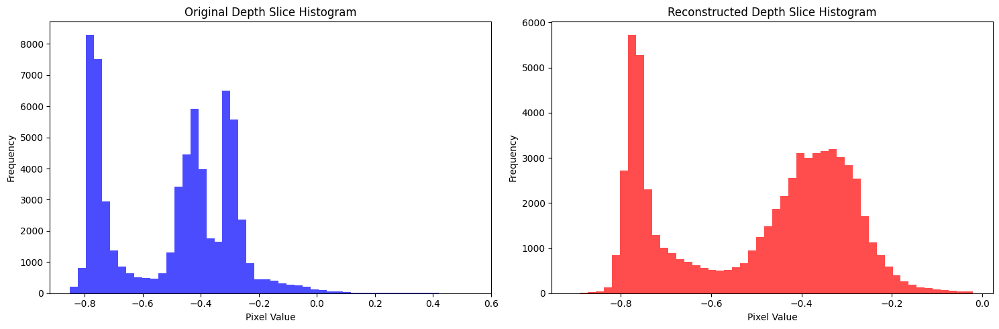

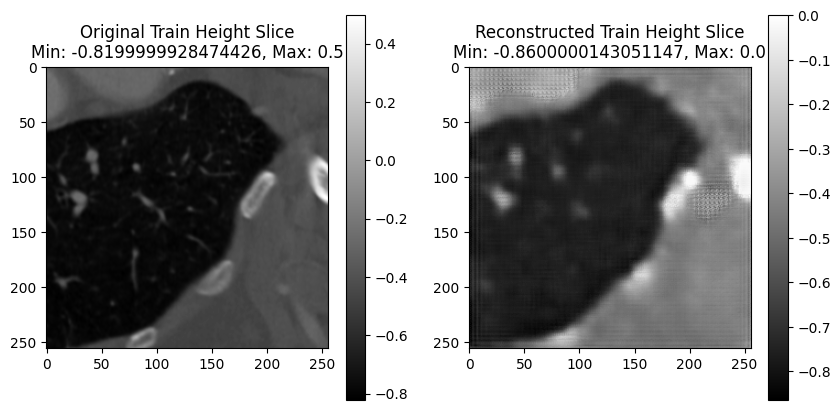

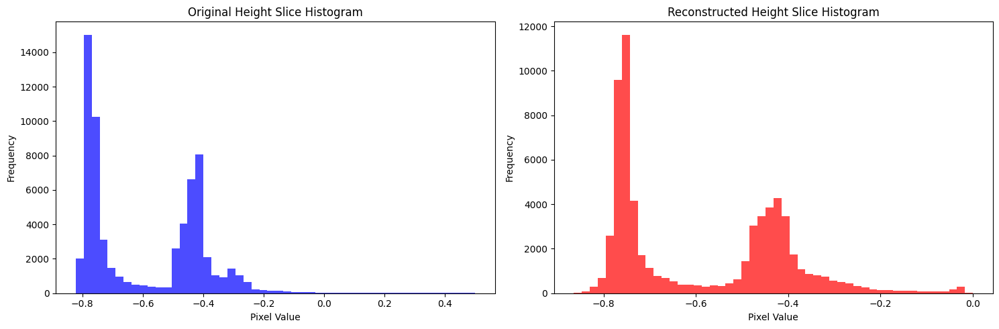

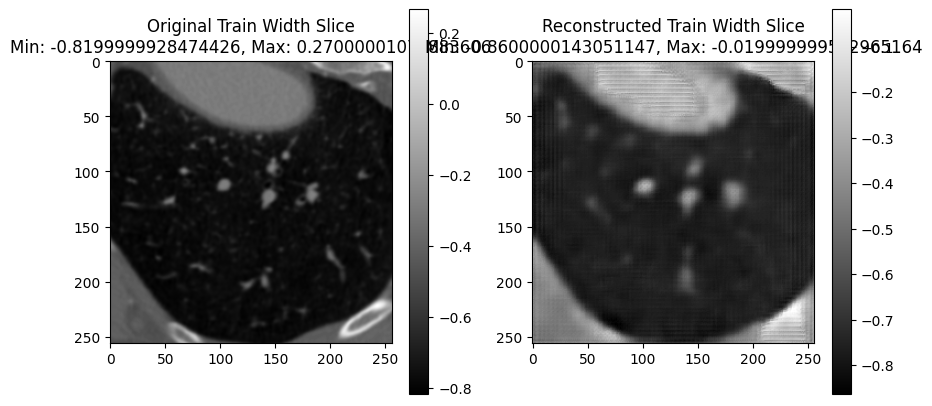

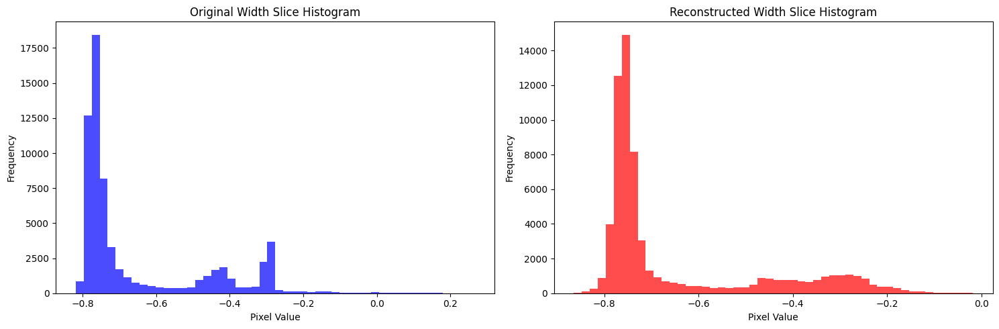

Validation: |          | 0/? [00:00<?, ?it/s]

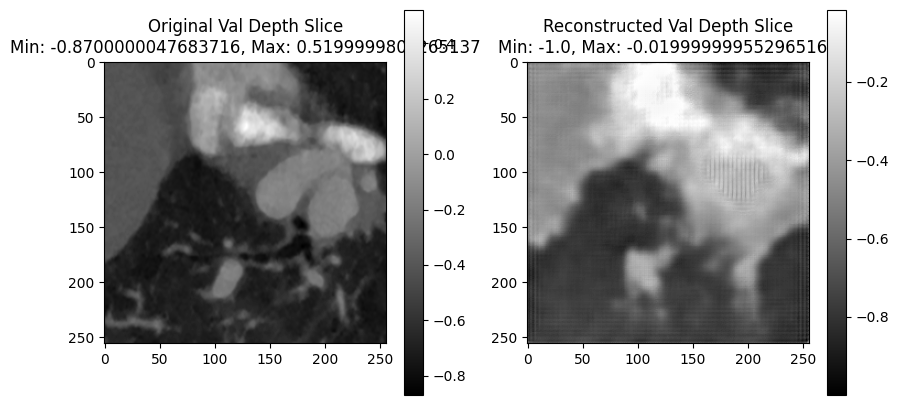

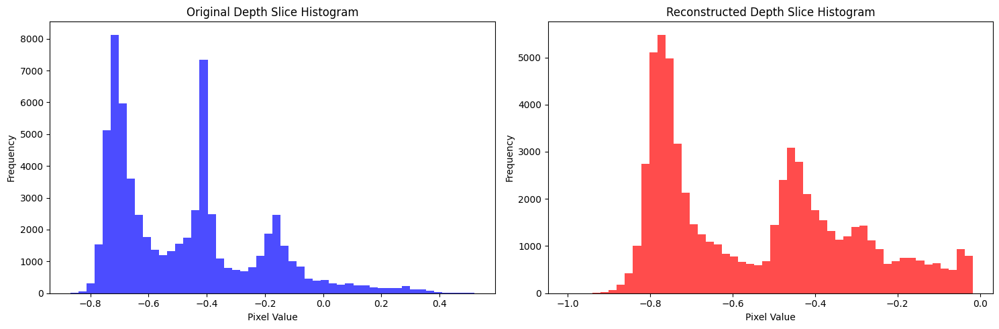

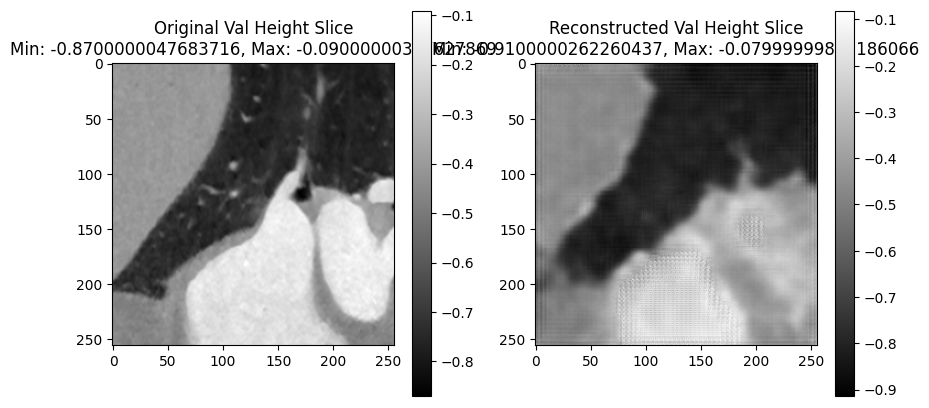

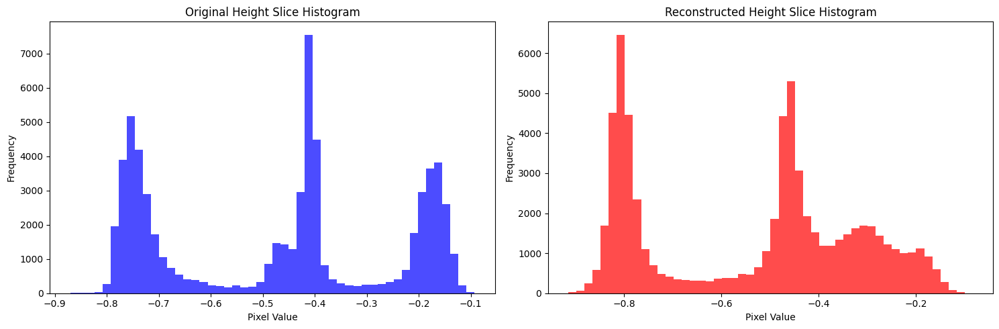

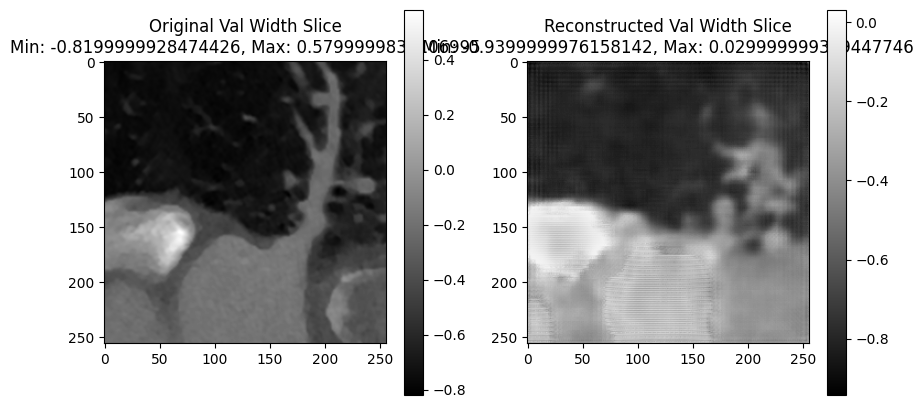

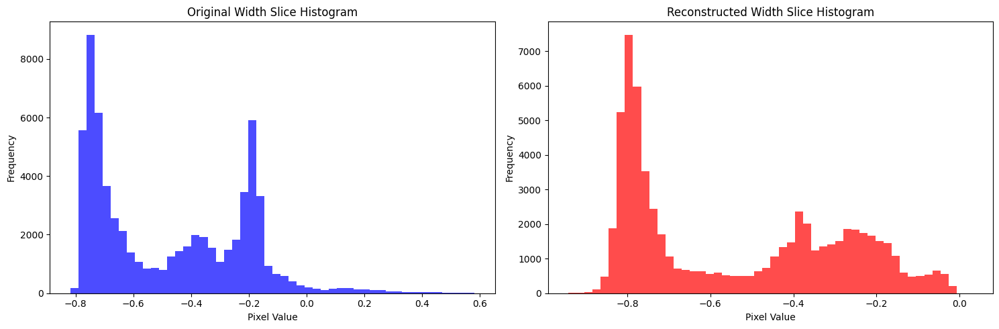

Time Spent 11641.71
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11653.77
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11666.57
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11679.28
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11691.86
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11704.43
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11717.12
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11732.05
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11744.07
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11756.86
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11769.40
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11781.47
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11793.58
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11805.59
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11817.72
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11829.94
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11842.54
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11855.07
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11867.75
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11880.33
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11892.91
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11905.62
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11918.19
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11930.76
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11943.46
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11956.06
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11968.63
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11981.16
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11993.99
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12006.59
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12019.16
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12031.72
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12044.52
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12057.11
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12069.64
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12082.32
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12094.87
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12107.45
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12122.39
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12138.45
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12163.86
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12208.50
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12223.70
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12235.65
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12247.60
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12259.56
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12271.61
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12284.12
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12296.69
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12309.33
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12321.44
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12333.43
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12345.42
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12357.80
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12370.34
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12382.49
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12394.52
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12406.59
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12418.96
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12431.52
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12444.18
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12456.38
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12468.36
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12480.33
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12492.48
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12504.67
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12517.20
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12529.45
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12541.47
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12553.44
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12565.41
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12577.60
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12589.60
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12602.07
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12614.93
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12628.15
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12640.71
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12653.12
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12803.63
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12820.59
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12834.81
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12849.52
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12864.50
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12880.10
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12895.02
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12909.43
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12924.81
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12936.81
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12948.79
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12960.84
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12972.88
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12984.89
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12998.73
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13011.39
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13023.95
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13036.53
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13049.20
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13061.76
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13074.31
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13087.00
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13099.67
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13112.23
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13124.81
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13137.50
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13150.10
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13162.68
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13175.24
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13188.08
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13200.14
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13212.22
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13224.38
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13236.38
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13248.37
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13260.38
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13272.54
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13284.60
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13296.58
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13308.65
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13320.63
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13332.61
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13344.58
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13356.67
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13368.63
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13380.75
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13392.93
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13405.01
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13417.02
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13428.97
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13441.05
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13453.00
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13465.02
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13477.02
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13489.11
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13501.09
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13513.08
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13525.15
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13537.40
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13550.00
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13562.07
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13574.14
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13586.11
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13598.08
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13610.13
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13622.08
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13634.03
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13646.00
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13658.08
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13670.07
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13682.55
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13695.26
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13707.84
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13720.42
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13733.00
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13745.69
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13758.28
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13770.88
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13783.28
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13795.40
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13807.42
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13819.40
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13831.49
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13843.45
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13855.44
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13867.42
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13879.94
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13892.02
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13904.01
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13916.15
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13928.14
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13940.12
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13952.54
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13965.22
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13977.79
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13989.91
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14002.01
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14014.01
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14026.03
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14038.16
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14050.21
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14062.21
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14074.21
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14086.50
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14099.23
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14111.45
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14123.46
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14135.60
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14147.54
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14159.48
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14171.47
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14183.51
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14195.48
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14207.44
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14219.57
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14231.53
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14243.49
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14255.46
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14267.47
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14279.38
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14291.32
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14303.41
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14315.41
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14327.86
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14340.41
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14353.09
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14365.61
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14378.17
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14390.29
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14402.42
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14414.39
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14426.36
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14438.42
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14450.35
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14462.32
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14474.29
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14486.35
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14498.37
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14510.32
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14522.39
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14534.36
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14546.33
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14558.40
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14570.56
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14582.58
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14594.61
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14606.82
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14618.82
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14630.81
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14642.81
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14654.92
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14667.33
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14679.31
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14691.31
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14703.39
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14715.34
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14727.58
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14739.67
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14751.66
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14764.04
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14776.61
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14789.27
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14801.85
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14814.12
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14826.20
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14838.15
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14850.30
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14862.86
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14875.52
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14888.09
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14900.65
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14913.34
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14925.91
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14938.43
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14950.43
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14962.73
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14974.72
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14986.68
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14998.63
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15010.70
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15022.83
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15035.12
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15047.18
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15059.15
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15071.14
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15083.14
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15095.79
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15108.35
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15120.94
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15133.62
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15145.96
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15157.97
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15169.97
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15182.03
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15194.49
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15207.04
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15219.73
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15232.28
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15244.84
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15257.12
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15269.24
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15281.19
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15293.16
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15305.08
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15317.13
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15329.08
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15341.06
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15353.14
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15365.11
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15377.11
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15389.31
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15401.47
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15413.87
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15426.26
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15438.40
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15450.35
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15462.30
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15474.23
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15486.26
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15498.22
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15510.19
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15522.28
Epoch: 1200


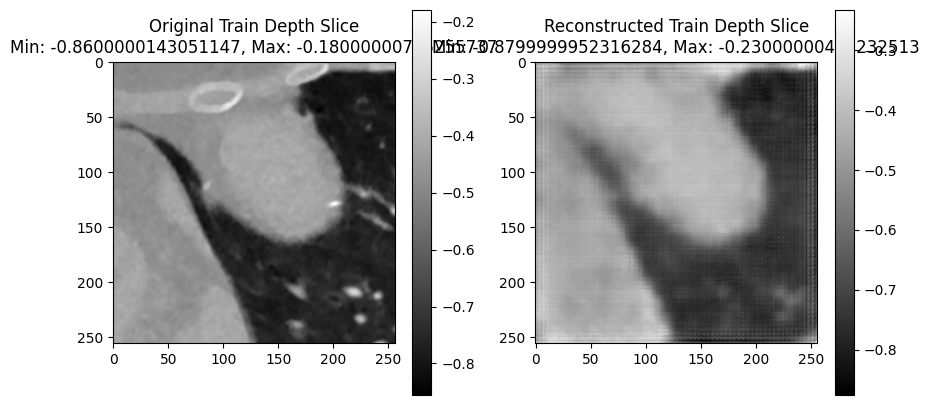

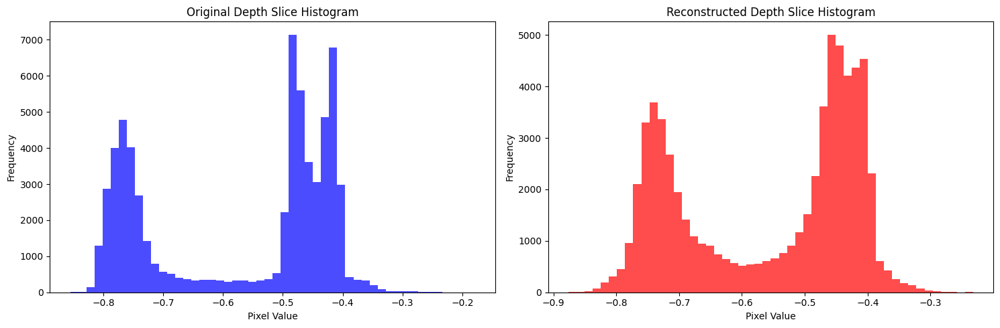

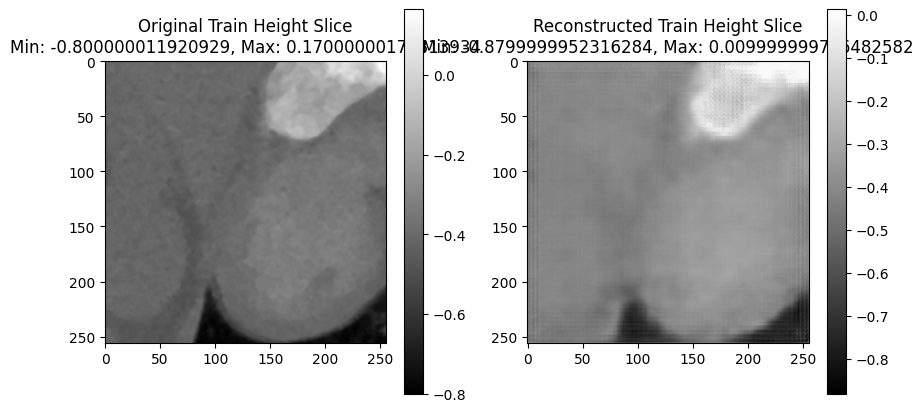

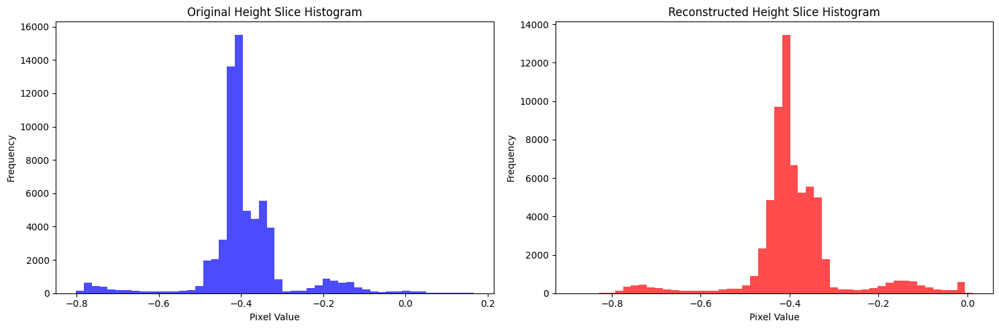

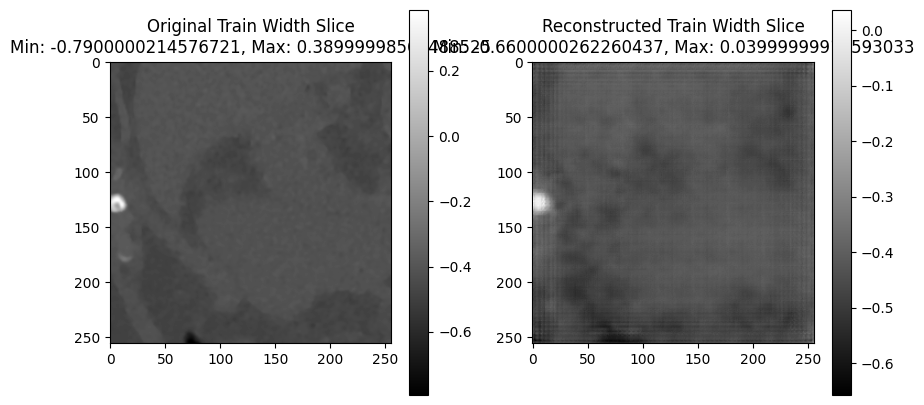

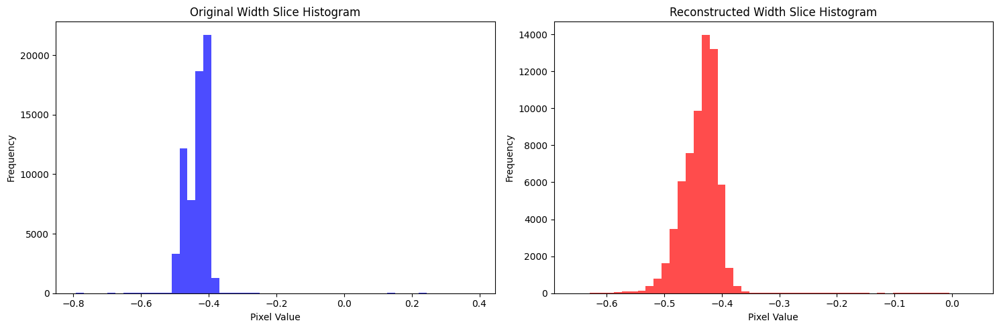

Validation: |          | 0/? [00:00<?, ?it/s]

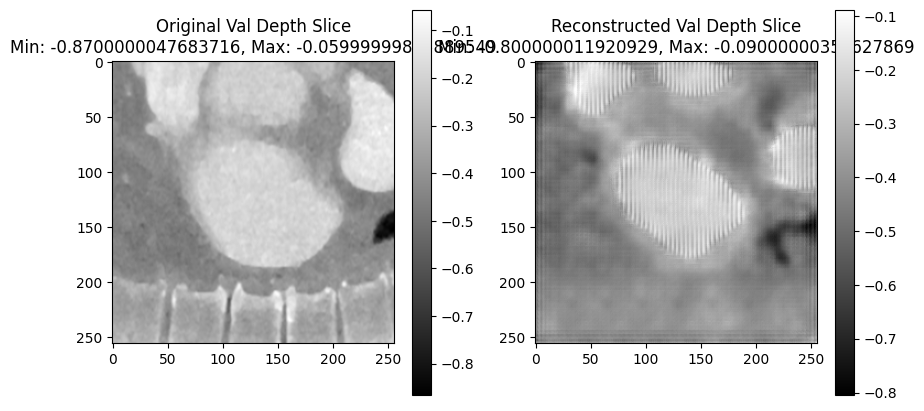

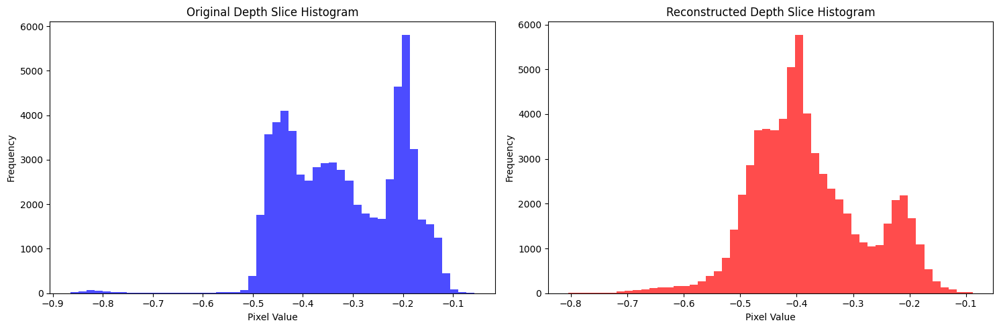

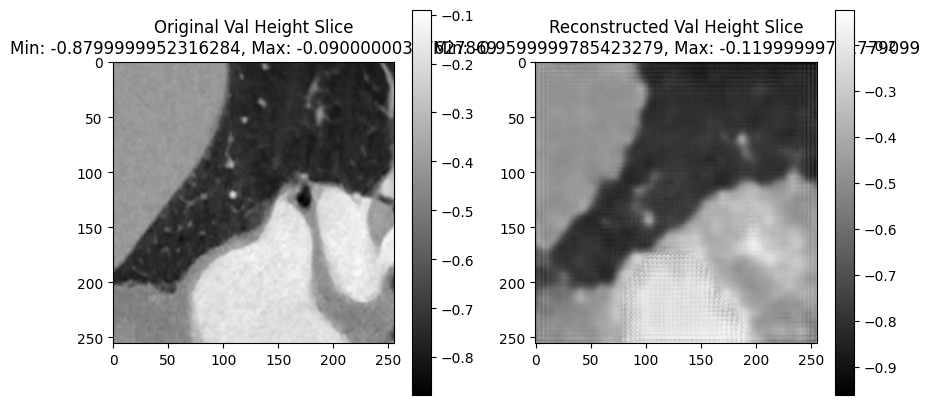

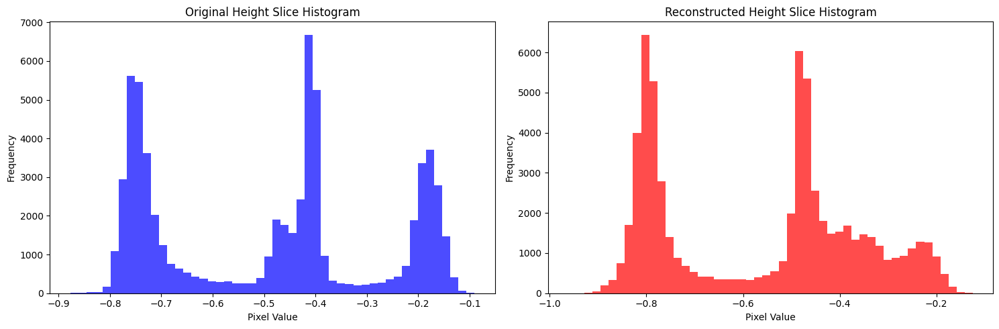

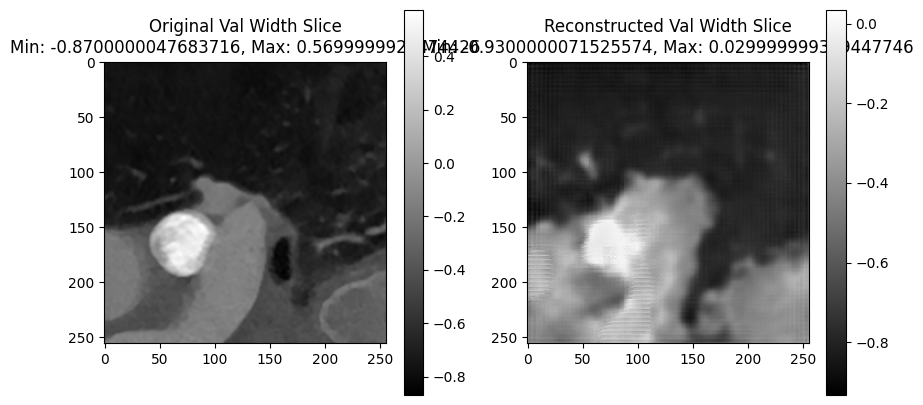

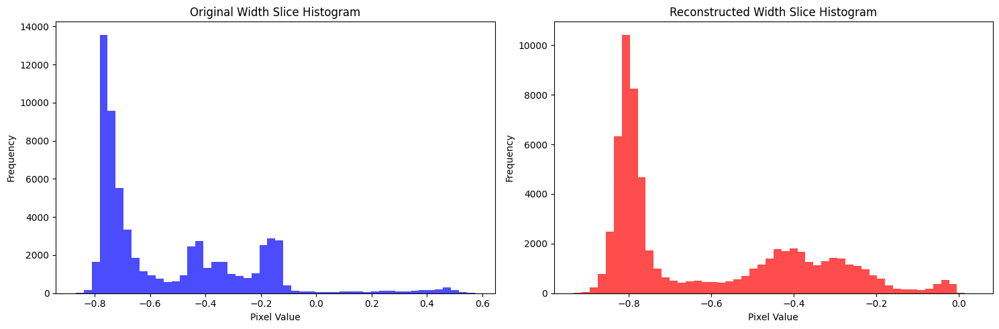

Time Spent 15541.56
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15553.52
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15565.53
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15577.70
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15589.70
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15601.69
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15613.68
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15625.78
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15637.75
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15649.77
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15662.02
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15674.03
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15686.03
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15698.05
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15710.17
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15722.19
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15734.18
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15746.54
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15758.75
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15770.74
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15782.78
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15794.83
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15806.81
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15818.78
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15830.84
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15842.84
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15854.82
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15866.79
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15878.86
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15890.85
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15902.81
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15914.79
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15926.91
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15938.88
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15951.16
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15963.85
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15976.42
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15988.98
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16001.54
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16014.21
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16026.75
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16039.30
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16051.48
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16063.48
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16075.47
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16087.48
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16099.60
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16111.58
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16123.60
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16135.70
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16147.70
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16159.69
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16171.71
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16183.82
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16195.80
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16207.78
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16219.80
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16232.19
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16244.62
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16256.71
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16269.29
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16281.84
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16294.41
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16306.71
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16318.84
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16330.83
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16342.93
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16355.21
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16367.25
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16379.22
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16391.15
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16403.21
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16415.15
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16427.10
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16439.18
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16451.14
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16463.11
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16475.58
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16488.30
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16500.89
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16513.46
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16525.96
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16538.62
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16550.80
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16562.85
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16575.34
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16587.88
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16600.18
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16612.20
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16624.29
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16636.34
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16648.40
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16660.45
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16672.42
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16684.39
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16696.55
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16709.21
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16721.80
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16734.37
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16747.05
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16759.62
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16772.19
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16784.72
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16797.38
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16809.61
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16821.59
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16833.56
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16845.66
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16857.69
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16869.70
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16881.86
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16894.46
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16907.03
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16919.59
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16932.26
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16944.82
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16957.14
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16969.29
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16981.78
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16994.35
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17006.91
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17019.62
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17032.19
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17044.79
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17057.44
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17069.46
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17081.45
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17093.44
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17105.52
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17117.51
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17129.82
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17142.36
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17155.03
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17167.58
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17180.11
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17192.58
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17204.53
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17216.49
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17228.45
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17240.53
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17252.83
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17265.38
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17278.04
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17290.63
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17303.26
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17315.55
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17327.69
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17339.67
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17352.07
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17364.80
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17377.35
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17389.92
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17402.51
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17414.72
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17426.75
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17438.71
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17450.68
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17462.74
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17474.85
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17486.90
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17498.95
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17510.91
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17523.23
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17535.79
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17548.13
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17560.12
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17572.22
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17584.73
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17597.28
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17609.84
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17622.03
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17634.10
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17646.07
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17658.42
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17671.07
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17683.63
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17695.94
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17707.92
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17720.56
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17733.15
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17745.71
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17758.28
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17770.63
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17782.67
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17794.79
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17807.14
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17819.69
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17832.25
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17844.80
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17857.44
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17869.57
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17881.54
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17893.61
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17906.15
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17918.46
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17930.48
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17942.65
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17954.63
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17966.63
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17979.35
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17992.06
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18004.11
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18016.08
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18028.16
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18040.12
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18052.20
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18064.16
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18076.36
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18088.64
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18101.18
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18113.43
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18125.55
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18137.54
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18149.53
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18161.92
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18174.26
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18186.22
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18198.28
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18210.27
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18222.29
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18234.31
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18246.37
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18258.36
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18270.43
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18282.56
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18294.55
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18307.01
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18319.57
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18332.26
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18344.33
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18356.35
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18368.66
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18380.85
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18393.38
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18405.65
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18417.79
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18429.75
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18441.75
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18453.71
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18465.81
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18478.00
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18490.55
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18503.08
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18515.63
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18528.19
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18540.80
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18553.46
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18566.02
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18578.58
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18591.26
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18603.28
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18615.25
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18627.46
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18639.54
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18651.53
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18663.53
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18675.72
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18688.38
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18700.96
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18713.52
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18726.20
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18738.78
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18751.26
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18763.80
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18776.45
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18789.00
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18801.59
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18814.28
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18826.85
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18839.41
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18851.95
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18864.69
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18877.26
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18889.82
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18901.97
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18913.93
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18925.97
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18937.96
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18950.05
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18962.03
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18974.00
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18986.57
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18998.86
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19010.94
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19023.56
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19036.24
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19048.89
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19061.46
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19074.06
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19086.74
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19099.31
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19111.84
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19124.49
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19137.03
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19149.61
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19162.15
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19174.80
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19187.33
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19199.92
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 19212.58
Epoch: 1500


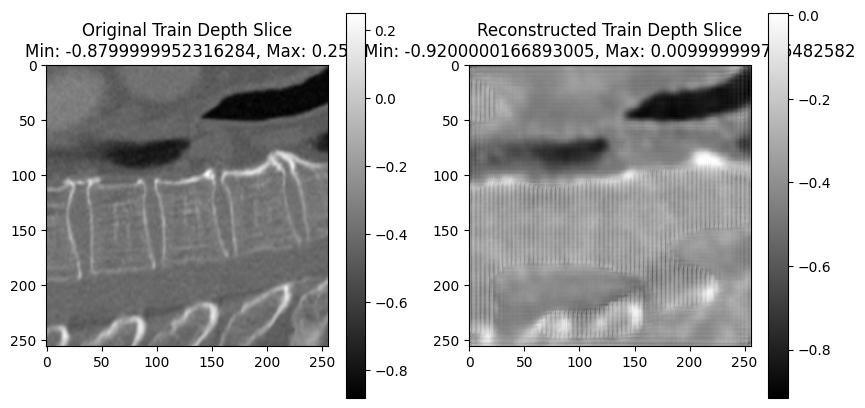

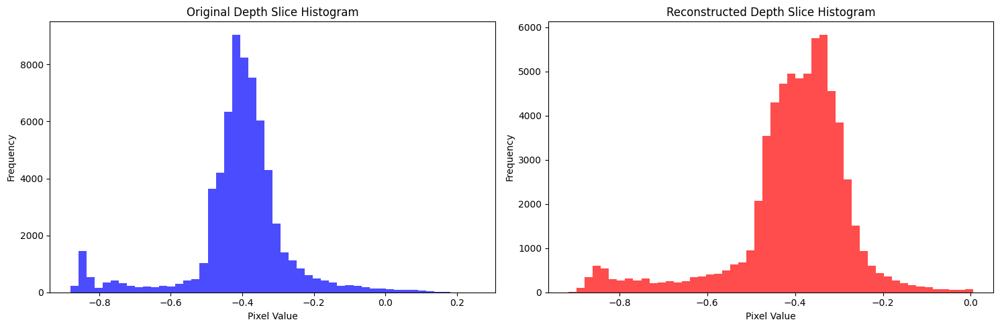

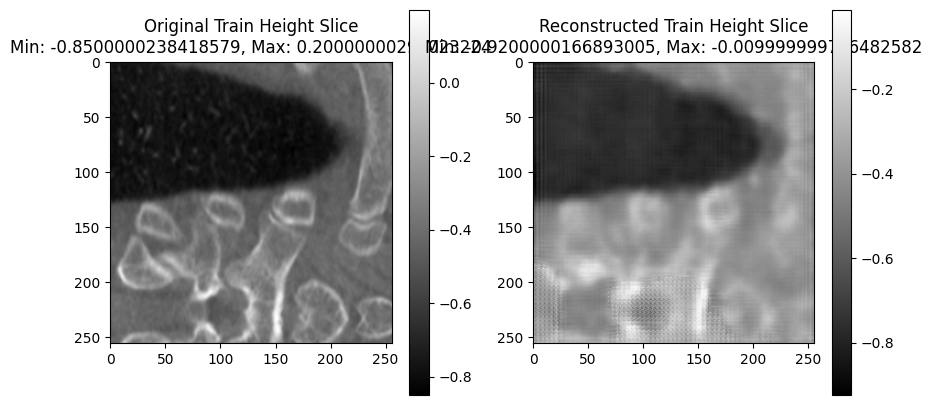

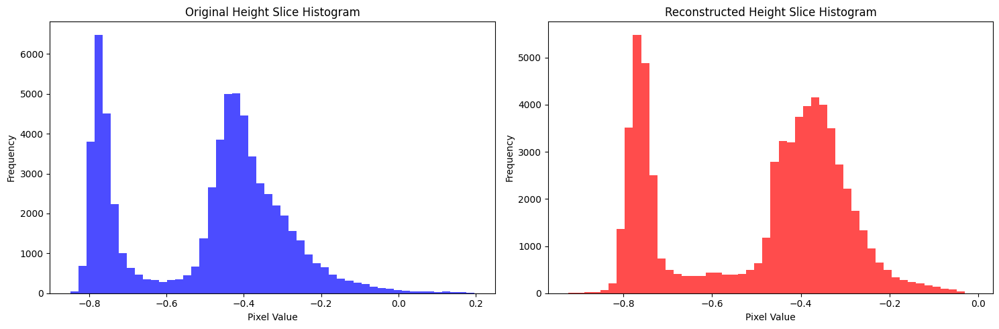

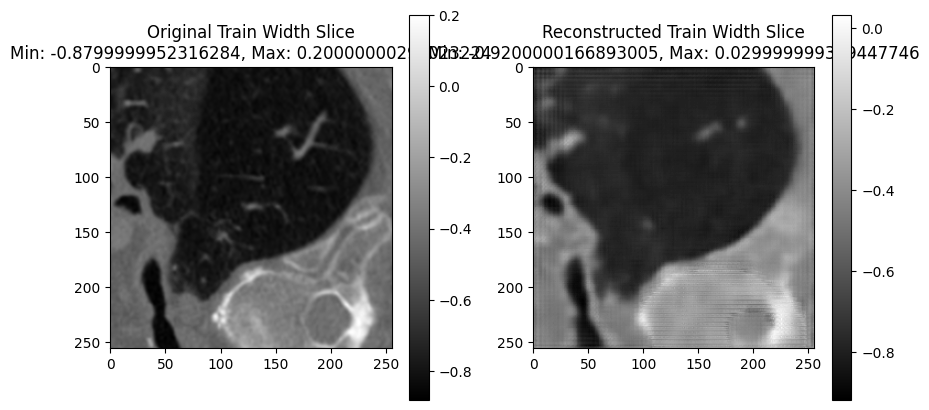

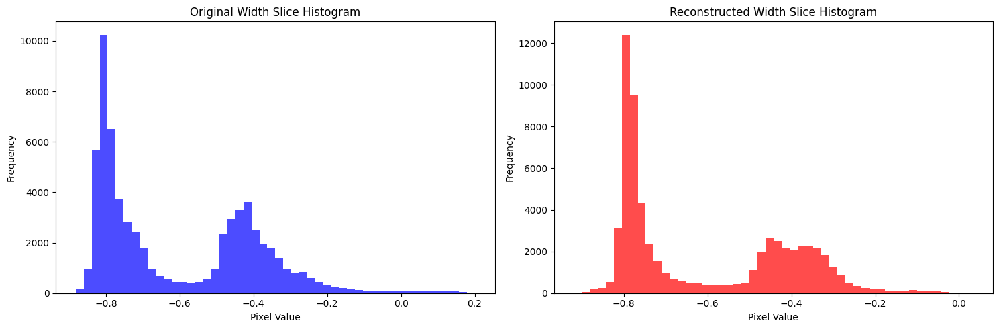

Validation: |          | 0/? [00:00<?, ?it/s]

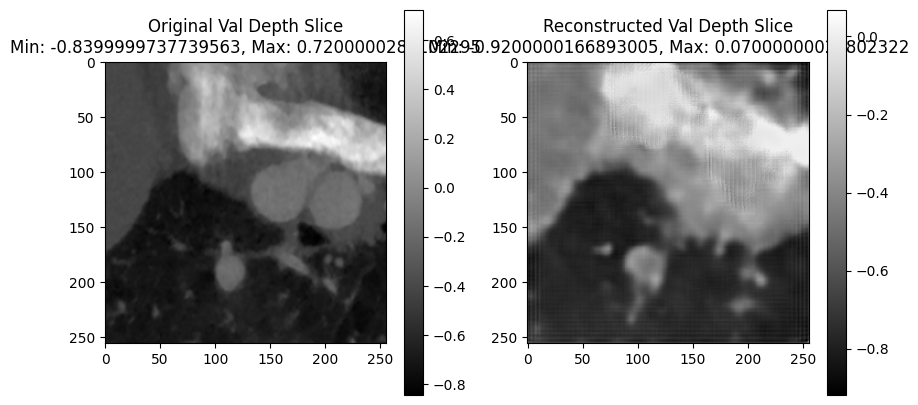

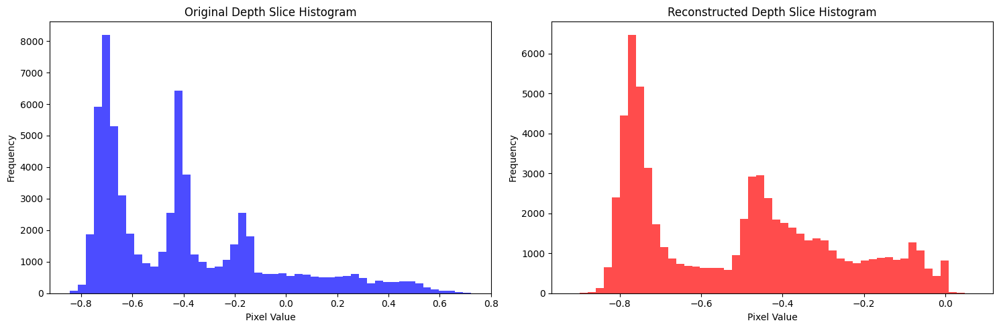

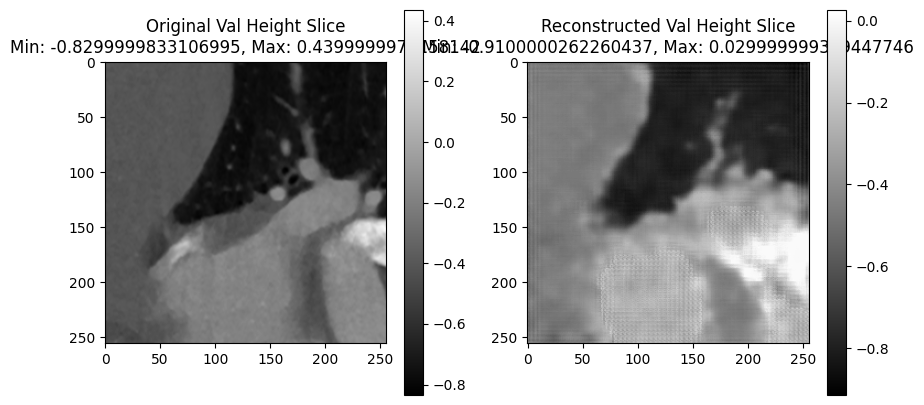

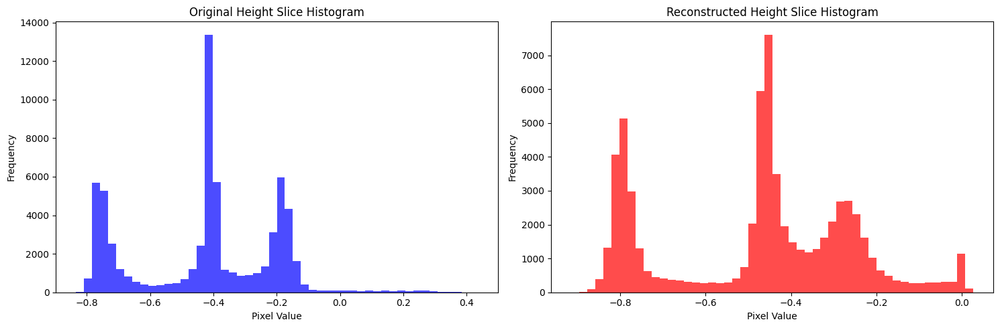

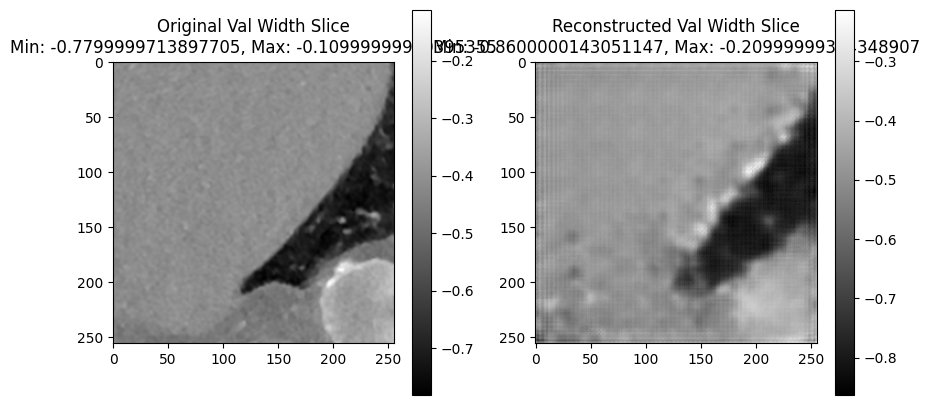

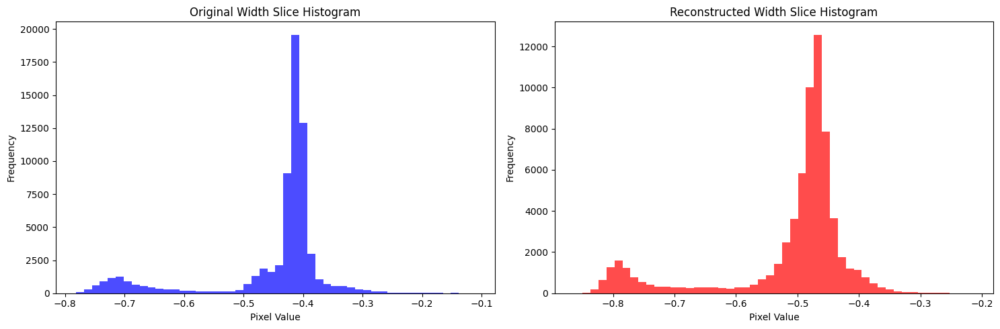

`Trainer.fit` stopped: `max_epochs=1501` reached.


Time Spent 19232.14
Epoch: 1501


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1086857      

In [5]:
# Initialize model and start training
ExperimentDescription = 'I-AE Job13 1C Loss'
ShowInterval = 300
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
# torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')